<a href="https://colab.research.google.com/github/RishitSingh10/Time-Series-Anomaly-Detection/blob/main/DADA_HMM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.chdir('/content/drive/MyDrive/amg_project/')

In [ ]:
%%capture
!pip install -r requirements.txt

In [ ]:
# !git clone https://github.com/decisionintelligence/DADA.git

In [ ]:
!sh ./scripts/DADA.sh

True
Use GPU: cuda:0
2025-05-06 05:56:23.939552: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746510984.150063    3695 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746510984.217602    3695 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
loading MSL(test) percentage: 100% ...done!
loading MSL(init) percentage: 100% ...done!
    Affiliation_thre  Affiliation_ACC  ...  Affiliation_R  Affiliation_F1
0              0.230         0.878874  ...       0.905679        0.781027
1              0.231         0.879009  ...       0.905616        0.781148
2              0.232         0.879118  ...       0.905613        0.781802
3              0.233         0.8

In [ ]:
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/amg_project/DADA/dataset/evaluation_dataset/data/PSM.csv")
df.head()

,date,data,cols
0,1,0.732689,feature_0
1,2,0.732799,feature_0
2,3,0.732938,feature_0
3,4,0.732893,feature_0
4,5,0.732788,feature_0


<Axes: >

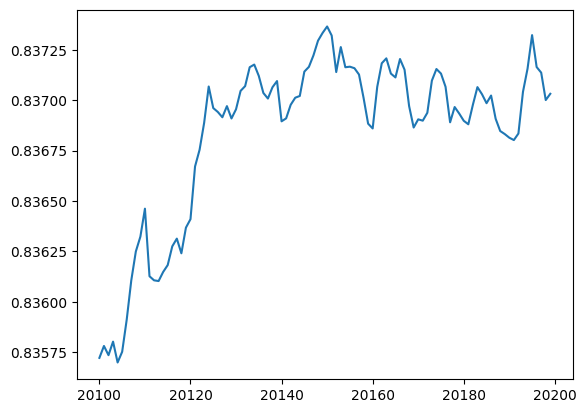

In [ ]:
df_col = df[df.cols == "feature_0"]
df_col.data.iloc[20100:20200].plot()

## DADA Architecture

In [ ]:
from transformers import PreTrainedModel
from DADA.configuration_DADA import DADAConfig
from typing import Optional, Any, Tuple
from torch.autograd import Function
from torch.distributions.normal import Normal
import torch
from torch import nn
import torch.nn.functional as F
import numpy as np


class DADA(PreTrainedModel):
    configs_class = DADAConfig

    def __init__(self, config):
        super().__init__(config)
        self.model = Model(
            seq_len=config.seq_len[0],
            hidden_dim=config.hidden_dim[0],
            d_model=config.d_model[0],
            bn_dims=config.bn_dims[0],
            k=config.k[0],
            patch_len=config.patch_len[0],
            mask_mode=config.mask_mode[0],
            depth=config.depth[0],
            max_iters=config.max_iters[0],
        )

    def infer(self, x, anomaly_criterion=None, norm=0, L=1):
        out_copies = self.model.infer(x, norm=norm)
        score = self.model.cal_anomaly_score(batch_x=x, batch_out_copies=out_copies, anomaly_criterion=anomaly_criterion, L=L)
        return score


class Model(nn.Module):
    def __init__(self, seq_len, hidden_dim, d_model, bn_dims, k, patch_len, mask_mode, depth, max_iters):
        super().__init__()
        win_size = seq_len
        hidden_dim = hidden_dim
        self.repr_dim = d_model
        depth = depth
        bn_dims = bn_dims
        k = k
        max_iters = max_iters
        # Patch
        self.patch_len = patch_len
        if win_size % self.patch_len:
            self.patch_num = (win_size // self.patch_len) + 1
        else:
            self.patch_num = win_size // self.patch_len
        # Encoder
        self.mask_mode = mask_mode
        self.input_embed = nn.Linear(self.patch_len, hidden_dim)
        self.encoder = Encoder(
            patch_len=self.patch_len,
            patch_num=self.patch_num,
            output_dims=self.repr_dim,
            hidden_dims=hidden_dim,
            depth=depth,
            backbone="dilated_conv",
        )
        # BottleNeck
        self.adaptive_bottleneck = AdaptiveBottleNeck(
            seq_len=self.patch_num,
            seq_dim=self.repr_dim, # update
            repr_dim=self.repr_dim,
            bn_dims=bn_dims,
            k=k,
        )
        # Decoder
        self.decoder = MLP_Decoder(self.repr_dim, self.patch_len)
        self.adv_decoder = MLP_Decoder(self.repr_dim, self.patch_len)
        self.grl = WarmStartGradientReverseLayer(hi=0.5, max_iters=max_iters, auto_step=True)

    def infer(self, x, norm=0, mask_mode=None, copies=10):
        if mask_mode is None:
            mask_mode = self.mask_mode
        B, T, dims = x.size()
        # 0.normalization
        if norm:
            means = x.mean(1, keepdim=True).detach()
            x = x - means
            stdev = torch.sqrt(torch.var(x, dim=1, keepdim=True, unbiased=False) + 1e-5)
            x /= stdev
        # 1.channel independence
        x = x.permute(0, 2, 1) # b x c x t
        x = x.reshape(B*dims, T) # b*c x t
        # 2.do patch
        if T % self.patch_len != 0:
            length = self.patch_num * self.patch_len
            padding = torch.zeros([B, (length - T)]).to(x.device) # update
            input = torch.cat([x, padding], dim=1) # b*c x patch_num*patch_len
        else:
            length = T
            input = x # b*c x t
        input_patch = input.unfold(dimension=-1, size=self.patch_len, step=self.patch_len) # b*c x patch_num x patch_len
        input_patch = self.input_embed(input_patch)  # b*c x patch_num x hidden_dims
        # 3.mask: generate copies
        if mask_mode=="c":
            assert copies%2==0, "The number of copies of symmetric mask must be an even number"
            mask_1 = torch.from_numpy(np.random.binomial(1, 0.5, size=(B*dims*(copies//2), self.patch_num))).to(torch.bool)
            mask_2 = ~mask_1
            mask = torch.cat([mask_1, mask_2], dim=0) # b*c*copies x patch_num
            input_patch = input_patch.repeat(copies, 1, 1)
            input_patch[mask] = 0 # patch symmetry mask
        elif mask_mode=="random":
            mask = torch.from_numpy(np.random.binomial(1, 0.5, size=(B*dims*copies, self.patch_num))).to(torch.bool) # b*c*copies x patch_num
            input_patch = input_patch.repeat(copies, 1, 1)
            input_patch[mask] = 0
        elif mask_mode=="nomask":
            copies=1
        # 4.encoder
        repr = self.encoder(input_patch) # b*c*copies x patch_num x repr_dim
        # 5.adpBN
        repr = torch.reshape(repr, (-1, self.patch_num*self.repr_dim))
        repr, balance_loss = self.adaptive_bottleneck(repr, repr)
        repr = torch.reshape(repr, (-1, self.patch_num, self.repr_dim))
        # 5.norm decoder
        out = self.decoder(repr) # b*c*copies x patch_num*patch_len
        out = out.reshape(copies, B*dims, T)
        out = out[:, :, :T].reshape(copies, B, dims, T)
        out = out.permute(0, 1, 3, 2) # copies x b x t x c
        # de-Normalization
        if norm:
            out = out * stdev.unsqueeze(dim=0).repeat(copies, 1, 1, 1) + means.unsqueeze(dim=0).repeat(copies, 1, 1, 1)

        return out # copies x b x t x c

    def cal_anomaly_score(self, batch_x, batch_out_copies, anomaly_criterion=None, L=1):
        score = torch.var(batch_out_copies, dim=0)                  # b x t x c
        score = torch.mean(score, dim=-1)                           # b x t
        if anomaly_criterion is None:
            return score
        else:
            output_mean = torch.mean(batch_out_copies, dim=0)       # b x t x c
            recon_score = anomaly_criterion(output_mean, batch_x)
            score = L*score+(1-L)*torch.mean(recon_score, dim=-1)   # b x t
            return score


class Encoder(nn.Module):
    def __init__(self, patch_len, patch_num, output_dims=512, hidden_dims=64, depth=10, backbone="dilated_conv"):
        super().__init__()
        self.patch_len = patch_len
        self.output_dims = output_dims
        self.hidden_dims = hidden_dims
        self.backbone = backbone
        if backbone=="dilated_conv":
            self.feature_extractor = DilatedConvEncoder(
                hidden_dims, [hidden_dims] * depth + [output_dims], kernel_size=3
            )
        self.repr_dropout = nn.Dropout(p=0.1)

    def forward(self, x):
        x = x.permute(0, 2, 1)  # B x hidden_dims x patch_num
        repr = self.repr_dropout(self.feature_extractor(x)) # B x output_dims x patch_num
        repr = repr.permute(0, 2, 1)
        return repr # B x patch_num x output_dims


class MLP_Decoder(nn.Module):
    def __init__(self, input_dims, output_dims):
        super().__init__()
        hidden_dim = int(input_dims*2)
        self.net = nn.Sequential(
            nn.GELU(),
            nn.Linear(input_dims, hidden_dim),
            nn.GELU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.GELU(),
            nn.Linear(hidden_dim, output_dims),
        )
        self.flatten = nn.Flatten(-2)
    def forward(self, x): # b*c x patch_num x repr_dim
        x = self.net(x) # b*c x patch_num*patch_len
        x = self.flatten(x)
        return x


class Flatten_Decoder(nn.Module):
    def __init__(self, input_dims, output_dims):
        super().__init__()
        self.net = nn.Sequential(
            nn.Flatten(-2),
            nn.Linear(input_dims, output_dims),
        )
    def forward(self, x): # b*c x patch_num x repr_dim
        x = self.net(x) # b*c x patch_num*patch_len
        return x


class GradientReverseFunction(Function):

    @staticmethod
    def forward(ctx: Any, input: torch.Tensor, coeff: Optional[float] = 1.) -> torch.Tensor:
        ctx.coeff = coeff
        output = input * 1.0
        return output

    @staticmethod
    def backward(ctx: Any, grad_output: torch.Tensor) -> Tuple[torch.Tensor, Any]:
        return grad_output.neg() * ctx.coeff, None


class GradientReverseLayer(nn.Module):
    def __init__(self):
        super(GradientReverseLayer, self).__init__()

    def forward(self, *input):
        return GradientReverseFunction.apply(*input)


class WarmStartGradientReverseLayer(nn.Module):
    """Gradient Reverse Layer :math:`\mathcal{R}(x)` with warm start

        The forward and backward behaviours are:

        .. math::
            \mathcal{R}(x) = x,

            \dfrac{ d\mathcal{R}} {dx} = - \lambda I.

        :math:`\lambda` is initiated at :math:`lo` and is gradually changed to :math:`hi` using the following schedule:

        .. math::
            \lambda = \dfrac{2(hi-lo)}{1+\exp(- α \dfrac{i}{N})} - (hi-lo) + lo

        where :math:`i` is the iteration step.

        Args:
            alpha (float, optional): :math:`α`. Default: 1.0
            lo (float, optional): Initial value of :math:`\lambda`. Default: 0.0
            hi (float, optional): Final value of :math:`\lambda`. Default: 1.0
            max_iters (int, optional): :math:`N`. Default: 1000
            auto_step (bool, optional): If True, increase :math:`i` each time `forward` is called.
              Otherwise use function `step` to increase :math:`i`. Default: False
        """

    def __init__(self, alpha: Optional[float] = 1.0, lo: Optional[float] = 0.0, hi: Optional[float] = 1.,
                 max_iters: Optional[int] = 1000., auto_step: Optional[bool] = False):
        super(WarmStartGradientReverseLayer, self).__init__()
        self.alpha = alpha
        self.lo = lo
        self.hi = hi
        self.iter_num = 0
        self.max_iters = max_iters
        self.auto_step = auto_step

    def forward(self, input: torch.Tensor) -> torch.Tensor:
        """"""
        coeff = float(
            2.0 * (self.hi - self.lo) /
            (1.0 + np.exp(-self.alpha * self.iter_num / self.max_iters))
            - (self.hi - self.lo) + self.lo
        )
        if self.auto_step:
            self.step()
        return GradientReverseFunction.apply(input, coeff)

    def step(self):
        """Increase iteration number :math:`i` by 1"""
        self.iter_num += 1


class BottleNeck(nn.Module):
    """Create BottleNeck"""
    def __init__(self, seq_len, repr_dim, bn_dim):
        super(BottleNeck, self).__init__()
        self.seq_len = seq_len
        self.repr_dim = repr_dim
        self.net = nn.Sequential(
                        nn.Linear(repr_dim, bn_dim),
                        nn.GELU(),
                        nn.Linear(bn_dim, bn_dim),
                        nn.GELU(),
                        nn.Dropout(0.1),
                        nn.Linear(bn_dim, repr_dim),
                    )

    def forward(self, repr): # b*c x pN*repr_dim
        """
        compress the representation dimension and restore it.
        [batch_size, patch_num*repr_dim] -> [batch_size, patch_num*bn_dim] -> [batch_size, patch_num*repr_dim]

        Args:
            repr (tensor): [batch_size, patch_num*repr_dim]

        Returns:
            repr (tensor): [batch_size, patch_num*repr_dim]
        """
        res = repr
        repr = repr.reshape(-1, self.seq_len, self.repr_dim)
        repr = self.net(repr)
        repr = repr.reshape(-1, self.seq_len*self.repr_dim)
        repr = res + repr
        return repr


class AdaptiveBottleNeck(nn.Module):
    """
    Adaptive BottleNeck impleted by using sMoE
    """
    def __init__(self, seq_len, seq_dim, repr_dim, bn_dims=[8,16,32,64], noisy_gating=True, k=3):
        super(AdaptiveBottleNeck, self).__init__()
        self.noisy_gating = noisy_gating
        self.num_bottlenecks = len(bn_dims)
        self.k = k
        self.bottlenecks = nn.ModuleList([
            BottleNeck(seq_len, repr_dim, bn_dim) for bn_dim in bn_dims
        ])
        self.w_gate = nn.Parameter(torch.zeros(seq_len*seq_dim, self.num_bottlenecks), requires_grad=True)
        self.w_noise = nn.Parameter(torch.zeros(seq_len*seq_dim, self.num_bottlenecks), requires_grad=True)

        self.softplus = nn.Softplus()
        self.softmax = nn.Softmax(1)
        self.register_buffer("mean", torch.tensor([0.0]))
        self.register_buffer("std", torch.tensor([1.0]))
        assert(self.k <= self.num_bottlenecks)

    def cv_squared(self, x):
        """The squared coefficient of variation of a sample.
        Useful as a loss to encourage a positive distribution to be more uniform.
        Epsilons added for numerical stability.
        Returns 0 for an empty Tensor.
        Args:
        x: a `Tensor`.
        Returns:
        a `Scalar`.
        """
        eps = 1e-10
        # if only num_experts = 1

        if x.shape[0] == 1:
            return torch.tensor([0], device=x.device, dtype=x.dtype)
        return x.float().var() / (x.float().mean()**2 + eps)

    def _gates_to_load(self, gates):
        """Compute the true load per expert, given the gates.
        The load is the number of examples for which the corresponding gate is >0.
        Args:
        gates: a `Tensor` of shape [batch_size, n]
        Returns:
        a float32 `Tensor` of shape [n]
        """
        return (gates > 0).sum(0)

    def _prob_in_top_k(self, clean_values, noisy_values, noise_stddev, noisy_top_values):
        """Helper function to NoisyTopKGating.
        Computes the probability that value is in top k, given different random noise.
        This gives us a way of backpropagating from a loss that balances the number
        of times each expert is in the top k experts per example.
        In the case of no noise, pass in None for noise_stddev, and the result will
        not be differentiable.
        Args:
        clean_values: a `Tensor` of shape [batch, n].
        noisy_values: a `Tensor` of shape [batch, n].  Equal to clean values plus
          normally distributed noise with standard deviation noise_stddev.
        noise_stddev: a `Tensor` of shape [batch, n], or None
        noisy_top_values: a `Tensor` of shape [batch, m].
           "values" Output of tf.top_k(noisy_top_values, m).  m >= k+1
        Returns:
        a `Tensor` of shape [batch, n].
        """
        batch = clean_values.size(0)
        m = noisy_top_values.size(1)
        top_values_flat = noisy_top_values.flatten()

        threshold_positions_if_in = torch.arange(batch, device=clean_values.device) * m + self.k
        threshold_if_in = torch.unsqueeze(torch.gather(top_values_flat, 0, threshold_positions_if_in), 1)
        is_in = torch.gt(noisy_values, threshold_if_in)
        threshold_positions_if_out = threshold_positions_if_in - 1
        threshold_if_out = torch.unsqueeze(torch.gather(top_values_flat, 0, threshold_positions_if_out), 1)
        # is each value currently in the top k.
        normal = Normal(self.mean, self.std)
        prob_if_in = normal.cdf((clean_values - threshold_if_in)/noise_stddev)
        prob_if_out = normal.cdf((clean_values - threshold_if_out)/noise_stddev)
        prob = torch.where(is_in, prob_if_in, prob_if_out)
        return prob

    def noisy_top_k_gating(self, x, train, noise_epsilon=1e-2):
        """Noisy top-k gating.
          See paper: https://arxiv.org/abs/1701.06538.
          Args:
            x: input Tensor with shape [batch_size, input_size]
            train: a boolean - we only add noise at training time.
            noise_epsilon: a float
          Returns:
            gates: a Tensor with shape [batch_size, num_experts]
            load: a Tensor with shape [num_experts]
        """
        clean_logits = x @ self.w_gate
        if self.noisy_gating and train:
            raw_noise_stddev = x @ self.w_noise
            noise_stddev = ((self.softplus(raw_noise_stddev) + noise_epsilon))
            noisy_logits = clean_logits + (torch.randn_like(clean_logits) * noise_stddev)
            logits = noisy_logits
        else:
            logits = clean_logits   # B x bottleneck_num

        # calculate topk + 1 that will be needed for the noisy gates
        top_logits, top_indices = logits.topk(min(self.k + 1, self.num_bottlenecks), dim=1)
        top_k_logits = top_logits[:, :self.k]
        top_k_indices = top_indices[:, :self.k]
        top_k_gates = self.softmax(top_k_logits)

        zeros = torch.zeros_like(logits, requires_grad=True)
        gates = zeros.scatter(1, top_k_indices, top_k_gates)

        if self.noisy_gating and self.k < self.num_bottlenecks and train:
            load = (self._prob_in_top_k(clean_logits, noisy_logits, noise_stddev, top_logits)).sum(0)
        else:
            load = self._gates_to_load(gates)
        return gates, load

    def forward(self, router_input, repr, loss_coef=1e-2):
        """Args:
        router_input: tensor shape [batch_size, seq_len*seq_dim]
        repr: tensor shape [batch_size, seq_len*repr_dim]
        [loss_coef: a scalar - multiplier on load-balancing losses]

        Returns:
        repr: a tensor with shape [batch_size, seq_len*repr_dim].
        [extra_training_loss: a scalar.  This should be added into the overall
        training loss of the model.  The backpropagation of this loss
        encourages all experts to be approximately equally used across a batch.]
        """
        gates, load = self.noisy_top_k_gating(router_input, self.training)
        # calculate importance loss
        importance = gates.sum(0)
        loss = self.cv_squared(importance) + self.cv_squared(load)
        loss *= loss_coef

        dispatcher = SparseDispatcher(self.num_bottlenecks, gates)
        inputs = dispatcher.dispatch(repr)
        gates = dispatcher.expert_to_gates()
        outputs = [self.bottlenecks[i](inputs[i]) for i in range(self.num_bottlenecks)]
        repr = dispatcher.combine(outputs)
        return repr, loss


class SparseDispatcher(object):
    """Helper for implementing a mixture of experts.
    The purpose of this class is to create input minibatches for the
    experts and to combine the results of the experts to form a unified
    output tensor.
    There are two functions:
    dispatch - take an input Tensor and create input Tensors for each expert.
    combine - take output Tensors from each expert and form a combined output
      Tensor.  Outputs from different experts for the same batch element are
      summed together, weighted by the provided "gates".
    The class is initialized with a "gates" Tensor, which specifies which
    batch elements go to which experts, and the weights to use when combining
    the outputs.  Batch element b is sent to expert e iff gates[b, e] != 0.
    The inputs and outputs are all two-dimensional [batch, depth].
    Caller is responsible for collapsing additional dimensions prior to
    calling this class and reshaping the output to the original shape.
    See common_layers.reshape_like().
    Example use:
    gates: a float32 `Tensor` with shape `[batch_size, num_experts]`
    inputs: a float32 `Tensor` with shape `[batch_size, input_size]`
    experts: a list of length `num_experts` containing sub-networks.
    dispatcher = SparseDispatcher(num_experts, gates)
    expert_inputs = dispatcher.dispatch(inputs)
    expert_outputs = [experts[i](expert_inputs[i]) for i in range(num_experts)]
    outputs = dispatcher.combine(expert_outputs)
    The preceding code sets the output for a particular example b to:
    output[b] = Sum_i(gates[b, i] * experts[i](inputs[b]))
    This class takes advantage of sparsity in the gate matrix by including in the
    `Tensor`s for expert i only the batch elements for which `gates[b, i] > 0`.
    """

    def __init__(self, num_experts, gates):
        """Create a SparseDispatcher."""

        self._gates = gates
        self._num_experts = num_experts
        # sort experts
        sorted_experts, index_sorted_experts = torch.nonzero(gates).sort(0)
        # drop indices
        _, self._expert_index = sorted_experts.split(1, dim=1)
        # get according batch index for each expert
        self._batch_index = torch.nonzero(gates)[index_sorted_experts[:, 1], 0]
        # calculate num samples that each expert gets
        self._part_sizes = (gates > 0).sum(0).tolist()
        # expand gates to match with self._batch_index
        gates_exp = gates[self._batch_index.flatten()]
        self._nonzero_gates = torch.gather(gates_exp, 1, self._expert_index)

    def dispatch(self, inp):
        """Create one input Tensor for each expert.
        The `Tensor` for a expert `i` contains the slices of `inp` corresponding
        to the batch elements `b` where `gates[b, i] > 0`.
        Args:
          inp: a `Tensor` of shape "[batch_size, <extra_input_dims>]`
        Returns:
          a list of `num_experts` `Tensor`s with shapes
            `[expert_batch_size_i, <extra_input_dims>]`.
        """

        # assigns samples to experts whose gate is nonzero

        # expand according to batch index so we can just split by _part_sizes
        inp_exp = inp[self._batch_index].squeeze(1)
        return torch.split(inp_exp, self._part_sizes, dim=0)

    def combine(self, expert_out, multiply_by_gates=True):
        """Sum together the expert output, weighted by the gates.
        The slice corresponding to a particular batch element `b` is computed
        as the sum over all experts `i` of the expert output, weighted by the
        corresponding gate values.  If `multiply_by_gates` is set to False, the
        gate values are ignored.
        Args:
          expert_out: a list of `num_experts` `Tensor`s, each with shape
            `[expert_batch_size_i, <extra_output_dims>]`.
          multiply_by_gates: a boolean
        Returns:
          a `Tensor` with shape `[batch_size, <extra_output_dims>]`.
        """
        # apply exp to expert outputs, so we are not longer in log space
        stitched = torch.cat(expert_out, 0)
        if multiply_by_gates:
            stitched = stitched.mul(self._nonzero_gates)
        zeros = torch.zeros(self._gates.size(0), expert_out[-1].size(1), requires_grad=True, device=stitched.device)
        # combine samples that have been processed by the same k experts
        combined = zeros.index_add(0, self._batch_index, stitched.float())
        return combined

    def expert_to_gates(self):
        """Gate values corresponding to the examples in the per-expert `Tensor`s.
        Returns:
          a list of `num_experts` one-dimensional `Tensor`s with type `tf.float32`
              and shapes `[expert_batch_size_i]`
        """
        # split nonzero gates for each expert
        return torch.split(self._nonzero_gates, self._part_sizes, dim=0)


class SamePadConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, dilation=1, groups=1):
        super().__init__()
        self.receptive_field = (kernel_size - 1) * dilation + 1
        padding = self.receptive_field // 2
        self.conv = nn.Conv1d(
            in_channels,
            out_channels,
            kernel_size,
            padding=padding,
            dilation=dilation,
            groups=groups,
        )
        self.remove = 1 if self.receptive_field % 2 == 0 else 0

    def forward(self, x):
        out = self.conv(x)
        if self.remove > 0:
            out = out[:, :, : -self.remove]
        return out


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, dilation, final=False):
        super().__init__()
        self.conv1 = SamePadConv(in_channels, out_channels, kernel_size, dilation=dilation)
        self.conv2 = SamePadConv(out_channels, out_channels, kernel_size, dilation=dilation)
        self.projector = nn.Conv1d(in_channels, out_channels, 1) if in_channels != out_channels or final else None

    def forward(self, x):
        residual = x if self.projector is None else self.projector(x)
        x = F.gelu(x)
        x = self.conv1(x)
        x = F.gelu(x)
        x = self.conv2(x)
        return x + residual


class DilatedConvEncoder(nn.Module):
    def __init__(self, in_channels, channels, kernel_size):
        super().__init__()
        self.net = nn.Sequential(*[
            ConvBlock(
                channels[i - 1] if i > 0 else in_channels,
                channels[i],
                kernel_size=kernel_size,
                dilation=1,
                final=(i == len(channels) - 1),
            )
            for i in range(len(channels))
        ])

    def forward(self, x):
        return self.net(x)

/usr/local/lib/python3.11/dist-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(


In [ ]:
model = DADA(config=DADAConfig())
path = '/content/drive/MyDrive/amg_project/DADA/DADA/pytorch_model.bin'
state_dict = torch.load(path)
model.load_state_dict(state_dict)

<All keys matched successfully>

In [ ]:
print(model)

DADA(
  (model): Model(
    (input_embed): Linear(in_features=5, out_features=64, bias=True)
    (encoder): Encoder(
      (feature_extractor): DilatedConvEncoder(
        (net): Sequential(
          (0): ConvBlock(
            (conv1): SamePadConv(
              (conv): Conv1d(64, 64, kernel_size=(3,), stride=(1,), padding=(1,))
            )
            (conv2): SamePadConv(
              (conv): Conv1d(64, 64, kernel_size=(3,), stride=(1,), padding=(1,))
            )
          )
          (1): ConvBlock(
            (conv1): SamePadConv(
              (conv): Conv1d(64, 64, kernel_size=(3,), stride=(1,), padding=(1,))
            )
            (conv2): SamePadConv(
              (conv): Conv1d(64, 64, kernel_size=(3,), stride=(1,), padding=(1,))
            )
          )
          (2): ConvBlock(
            (conv1): SamePadConv(
              (conv): Conv1d(64, 64, kernel_size=(3,), stride=(1,), padding=(1,))
            )
            (conv2): SamePadConv(
              (conv): C

In [ ]:
import pandas as pd

df = pd.read_csv('/content/drive/MyDrive/amg_project/data/sample_data_october.csv')
df.head()

,speed,indo_time,tag_1,tag_2,tag_3
0,51193.0,2024-10-04 00:00:00+07:00,187.199997,512.400024,497.900024
1,50902.0,2024-10-04 00:00:01+07:00,187.199997,512.400024,497.900024
2,51009.0,2024-10-04 00:00:02+07:00,187.199997,512.400024,497.900024
3,51109.0,2024-10-04 00:00:03+07:00,187.199997,512.400024,497.900024
4,51103.0,2024-10-04 00:00:04+07:00,187.199997,512.400024,497.900024


<Axes: >

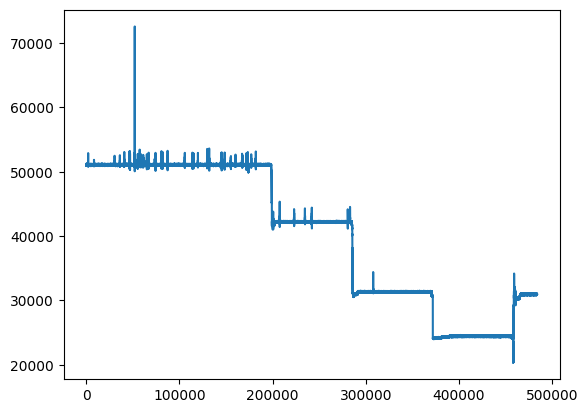

In [ ]:
df.speed.plot()

In [ ]:
df.speed.values[:-76].shape

(483600,)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def create_sequences(x, seq_len=100):
  seqs = []
  for i in range(0, len(x)-seq_len+1, seq_len):
    seqs.append(x[i:i+seq_len])
  return np.array(seqs)

seqs = create_sequences(df.speed.values, seq_len=100)

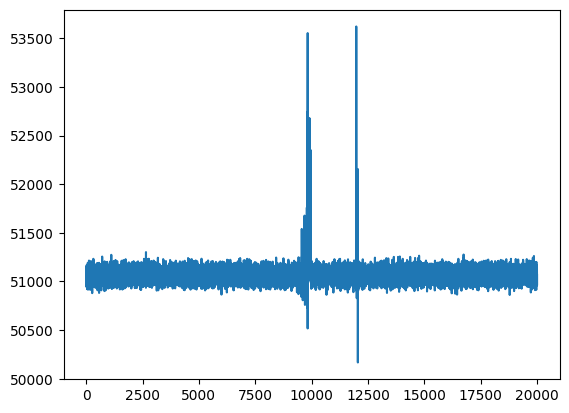

In [ ]:
data = df.speed.iloc[int(120e3):int(140e3)].values
plt.plot(data)

In [ ]:
input = np.sin(3*np.linspace(0,10,100))
input[60:70] = np.random.normal(0, 1, 10) #anomalous points
input = torch.tensor(input, dtype=torch.float32).reshape((1,100)).unsqueeze(-1)
with torch.no_grad():
  out = model.infer(input)

In [ ]:
out.shape

torch.Size([1, 100])

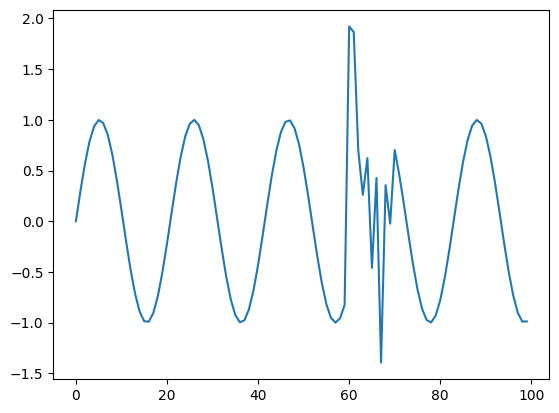

In [ ]:
plt.plot(input.reshape(-1))

In [ ]:
# # generate a timeseries of sine wave with 1000 datapoints
x_tensor = torch.tensor(data, dtype=torch.float32).reshape(200, 100).unsqueeze(-1)

In [ ]:
x_tensor.size()

torch.Size([200, 100, 1])

In [ ]:
with torch.no_grad():
  out = model.infer(x_tensor)

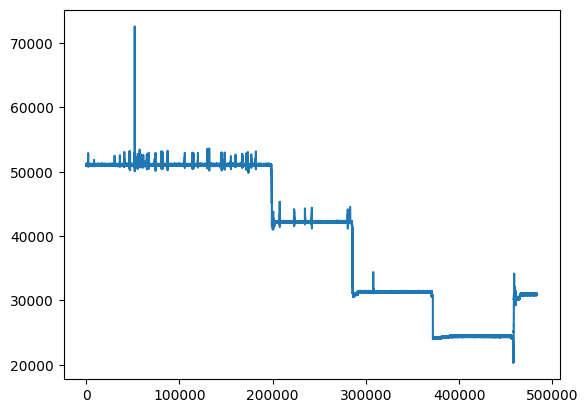

In [ ]:
plt.plot(seqs.reshape(-1))

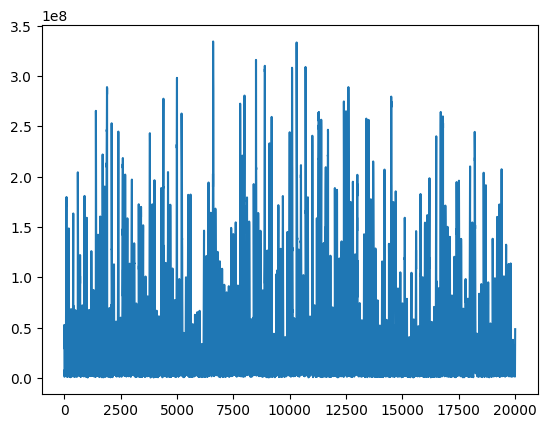

In [ ]:
plt.plot(out.reshape(-1))

In [ ]:
from math import log, floor

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.optimize import minimize
from tqdm import tqdm

deep_saffron = '#FF9933'
air_force_blue = '#5D8AA8'


class SPOT:
    def __init__(self, q=1e-4):
        self.proba = q
        self.extreme_quantile = None
        self.data = None
        self.init_data = None
        self.init_threshold = None
        self.peaks = None
        self.n = 0
        self.Nt = 0

    def __str__(self):
        s = ''
        s += 'Streaming Peaks-Over-Threshold Object\n'
        s += 'Detection level q = %s\n' % self.proba
        if self.data is not None:
            s += 'Data imported : Yes\n'
            s += '\t initialization  : %s values\n' % self.init_data.size
            s += '\t stream : %s values\n' % self.data.size
        else:
            s += 'Data imported : No\n'
            return s

        if self.n == 0:
            s += 'Algorithm initialized : No\n'
        else:
            s += 'Algorithm initialized : Yes\n'
            s += '\t initial threshold : %s\n' % self.init_threshold

            r = self.n - self.init_data.size
            if r > 0:
                s += 'Algorithm run : Yes\n'
                s += '\t number of observations : %s (%.2f %%)\n' % (r, 100 * r / self.n)
            else:
                s += '\t number of peaks  : %s\n' % self.Nt
                s += '\t extreme quantile : %s\n' % self.extreme_quantile
                s += 'Algorithm run : No\n'
        return s

    def fit(self, init_data, data):
        if isinstance(data, list):
            self.data = np.array(data)
        elif isinstance(data, np.ndarray):
            self.data = data
        elif isinstance(data, pd.Series):
            self.data = data.values
        else:
            print('This data format (%s) is not supported' % type(data))
            return

        if isinstance(init_data, list):
            self.init_data = np.array(init_data)
        elif isinstance(init_data, np.ndarray):
            self.init_data = init_data
        elif isinstance(init_data, pd.Series):
            self.init_data = init_data.values
        elif isinstance(init_data, int):
            self.init_data = self.data[:init_data]
            self.data = self.data[init_data:]
        elif isinstance(init_data, float) & (init_data < 1) & (init_data > 0):
            r = int(init_data * data.size)
            self.init_data = self.data[:r]
            self.data = self.data[r:]
        else:
            print('The initial data cannot be set')
            return

    def add(self, data):
        if isinstance(data, list):
            data = np.array(data)
        elif isinstance(data, np.ndarray):
            data = data
        elif isinstance(data, pd.Series):
            data = data.values
        else:
            print('This data format (%s) is not supported' % type(data))
            return

        self.data = np.append(self.data, data)
        return

    def initialize(self, level=0.98, verbose=True):
        level = level - floor(level)

        n_init = self.init_data.size

        S = np.sort(self.init_data)
        self.init_threshold = S[int(level * n_init)]

        self.peaks = self.init_data[self.init_data > self.init_threshold] - self.init_threshold
        self.Nt = self.peaks.size
        self.n = n_init

        if verbose:
            print('Initial threshold : %s' % self.init_threshold)
            print('Number of peaks : %s' % self.Nt)
            print('Grimshaw maximum log-likelihood estimation ... ', end='')

        g, s, l = self._grimshaw()
        self.extreme_quantile = self._quantile(g, s)

        if verbose:
            print('[done]')
            print('\t' + chr(0x03B3) + ' = ' + str(g))
            print('\t' + chr(0x03C3) + ' = ' + str(s))
            print('\tL = ' + str(l))
            print('Extreme quantile (probability = %s): %s' % (self.proba, self.extreme_quantile))

        return

    def _rootsFinder(fun, jac, bounds, npoints, method):
        if method == 'regular':
            step = (bounds[1] - bounds[0]) / (npoints + 1)
            X0 = np.arange(bounds[0] + step, bounds[1], step)
        elif method == 'random':
            X0 = np.random.uniform(bounds[0], bounds[1], npoints)

        def objFun(X, f, jac):
            g = 0
            j = np.zeros(X.shape)
            i = 0
            for x in X:
                fx = f(x)
                g = g + fx ** 2
                j[i] = 2 * fx * jac(x)
                i = i + 1
            return g, j

        opt = minimize(lambda X: objFun(X, fun, jac), X0,
                       method='L-BFGS-B',
                       jac=True, bounds=[bounds] * len(X0))

        X = opt.x
        np.round(X, decimals=5)
        return np.unique(X)

    def _log_likelihood(Y, gamma, sigma):
        n = Y.size
        if gamma != 0:
            tau = gamma / sigma
            L = -n * log(sigma) - (1 + (1 / gamma)) * (np.log(1 + tau * Y)).sum()
        else:
            L = n * (1 + log(Y.mean()))
        return L

    def _grimshaw(self, epsilon=1e-8, n_points=10):
        def u(s):
            return 1 + np.log(s).mean()

        def v(s):
            return np.mean(1 / s)

        def w(Y, t):
            s = 1 + t * Y
            us = u(s)
            vs = v(s)
            return us * vs - 1

        def jac_w(Y, t):
            s = 1 + t * Y
            us = u(s)
            vs = v(s)
            jac_us = (1 / t) * (1 - vs)
            jac_vs = (1 / t) * (-vs + np.mean(1 / s ** 2))
            return us * jac_vs + vs * jac_us

        Ym = self.peaks.min()
        YM = self.peaks.max()
        Ymean = self.peaks.mean()

        a = -1 / YM
        if abs(a) < 2 * epsilon:
            epsilon = abs(a) / n_points

        a = a + epsilon
        b = 2 * (Ymean - Ym) / (Ymean * Ym)
        c = 2 * (Ymean - Ym) / (Ym ** 2)

        left_zeros = SPOT._rootsFinder(lambda t: w(self.peaks, t),
                                       lambda t: jac_w(self.peaks, t),
                                       (a + epsilon, -epsilon),
                                       n_points, 'regular')

        right_zeros = SPOT._rootsFinder(lambda t: w(self.peaks, t),
                                        lambda t: jac_w(self.peaks, t),
                                        (b, c),
                                        n_points, 'regular')

        zeros = np.concatenate((left_zeros, right_zeros))

        gamma_best = 0
        sigma_best = Ymean
        ll_best = SPOT._log_likelihood(self.peaks, gamma_best, sigma_best)

        for z in zeros:
            gamma = u(1 + z * self.peaks) - 1
            sigma = gamma / z
            ll = SPOT._log_likelihood(self.peaks, gamma, sigma)
            if ll > ll_best:
                gamma_best = gamma
                sigma_best = sigma
                ll_best = ll

        return gamma_best, sigma_best, ll_best

    def _quantile(self, gamma, sigma):
        r = self.n * self.proba / self.Nt
        if gamma != 0:
            return self.init_threshold + (sigma / gamma) * (pow(r, -gamma) - 1)
        else:
            return self.init_threshold - sigma * log(r)

    def run(self, with_alarm=True):
        if self.n > self.init_data.size:
            print('Warning : the algorithm seems to have already been run, you \
            should initialize before running again')
            return {}

        th = []
        alarm = []
        for i in tqdm(range(self.data.size)):

            if self.data[i] > self.extreme_quantile:
                if with_alarm:
                    alarm.append(i)
                else:
                    self.peaks = np.append(self.peaks, self.data[i] - self.init_threshold)
                    self.Nt += 1
                    self.n += 1

                    g, s, l = self._grimshaw()
                    self.extreme_quantile = self._quantile(g, s)

            elif self.data[i] > self.init_threshold:
                self.peaks = np.append(self.peaks, self.data[i] - self.init_threshold)
                self.Nt += 1
                self.n += 1

                g, s, l = self._grimshaw()
                self.extreme_quantile = self._quantile(g, s)
            else:
                self.n += 1

            th.append(self.extreme_quantile)

        return {'thresholds': th, 'alarms': alarm}

    def plot(self, run_results, with_alarm=True):
        x = range(self.data.size)
        K = run_results.keys()

        ts_fig, = plt.plot(x, self.data, color=air_force_blue)
        fig = [ts_fig]

        if 'thresholds' in K:
            th = run_results['thresholds']
            th_fig, = plt.plot(x, th, color=deep_saffron, lw=2, ls='dashed')
            fig.append(th_fig)

        if with_alarm and ('alarms' in K):
            alarm = run_results['alarms']
            al_fig = plt.scatter(alarm, self.data[alarm], color='red')
            fig.append(al_fig)

        plt.xlim((0, self.data.size))

        return fig

In [ ]:
anomaly_scores = out.squeeze().detach().numpy()
init_score = anomaly_scores[:50]  # First 50 assumed normal
test_score = anomaly_scores       # Full score stream

In [ ]:
q = 0.01  # Tail probability (1% extreme values)
s = SPOT(q)
s.fit(init_score, test_score)
s.initialize(verbose=True)
result = s.run()

thresholds = result['thresholds']
alarms = result['alarms']  # indices flagged as anomalies

Initial threshold : 0.21945538
Number of peaks : 0
Grimshaw maximum log-likelihood estimation ... 

ValueError: zero-size array to reduction operation minimum which has no identity

### Matrix Profile

In [ ]:
!pip install "stumpy"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.5/176.5 kB 3.0 MB/s eta 0:00:00


In [ ]:
import stumpy
import numpy as np
import matplotlib.pyplot as plt

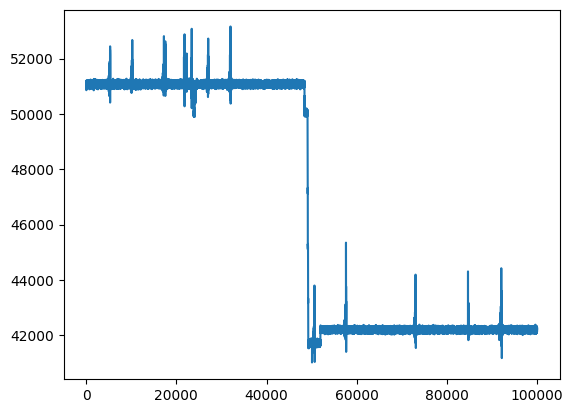

In [ ]:
data = df.speed.iloc[int(150e3):int(250e3)].values
plt.plot(data)

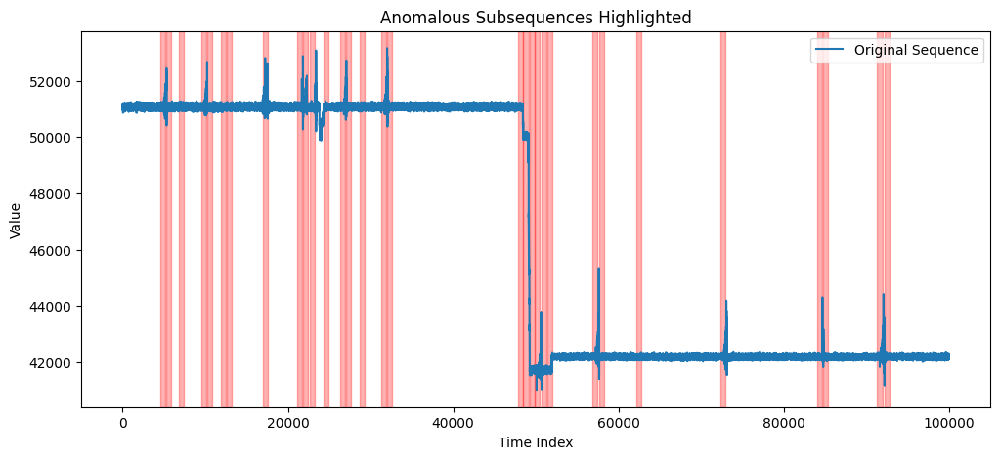

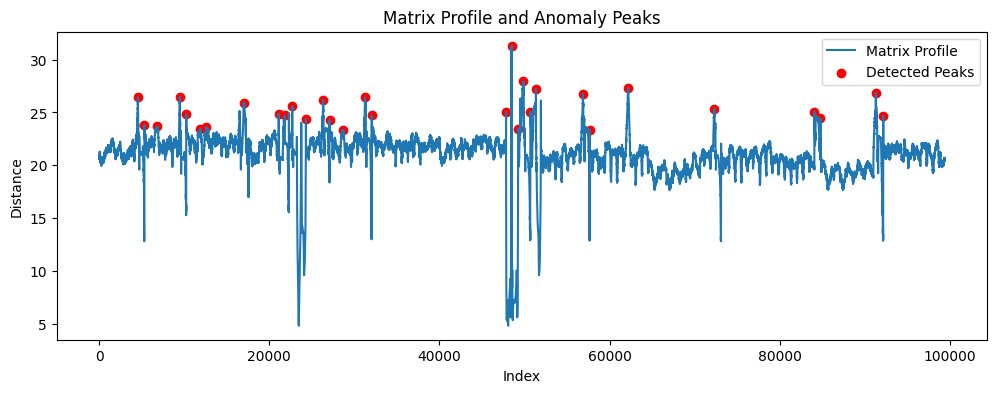

In [ ]:
from scipy.signal import find_peaks

np.random.seed(42)
m = 600
mp = stumpy.stump(data, m=m)
matrix_profile = mp[:, 0]

# Detect peaks in the matrix profile
peak_indices, _ = find_peaks(matrix_profile, distance=m, height=np.percentile(matrix_profile, 95))

# Plot the original time series with anomalies marked
plt.figure(figsize=(12, 5))
plt.plot(data, label="Original Sequence")

# Highlight anomalous subsequences
for idx in peak_indices:
    plt.axvspan(idx, idx + m, color='red', alpha=0.3)

plt.title("Anomalous Subsequences Highlighted")
plt.xlabel("Time Index")
plt.ylabel("Value")
plt.legend()
plt.show()

# Plot the matrix profile itself
plt.figure(figsize=(12, 4))
plt.plot(matrix_profile, label="Matrix Profile")
plt.scatter(peak_indices, matrix_profile[peak_indices], color='red', label="Detected Peaks")
plt.title("Matrix Profile and Anomaly Peaks")
plt.xlabel("Index")
plt.ylabel("Distance")
plt.legend()
plt.show()

## HMM Method

In [ ]:
%%capture
!pip install hmmlearn plotly

In [ ]:
# imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import os
import plotly.graph_objects as go

In [ ]:
path = "/content/drive/MyDrive/amg_project/"
import os
os.chdir(path)

In [ ]:
import pandas as pd
import os

path = './data/labelled_data/'
all_dfs = []

for f in os.listdir(path):
    if f.startswith('labelled_') and f.endswith('.csv'):
        print(f)
        full_path = os.path.join(path, f)
        df = pd.read_csv(full_path)
        all_dfs.append(df)

df = pd.concat(all_dfs, ignore_index=True)

labelled_0_44.csv
labelled_12_68.csv
labelled_13_74.csv
labelled_1_23.csv
labelled_2_37.csv
labelled_3_51.csv
labelled_4_53.csv
labelled_6_62.csv
labelled_7_62.csv
labelled_5_55.csv
labelled_8_62.csv
labelled_9_63.csv


In [ ]:
# First evaluating on a subset
sub_df = all_dfs[0]
sub_df.head()

,speed,indo_time,arrival,pred_label
0,44405,2024-04-12 02:59:04+07:00,0,0
1,44388,2024-04-12 02:59:05+07:00,0,0
2,44333,2024-04-12 02:59:06+07:00,0,0
3,44360,2024-04-12 02:59:07+07:00,0,0
4,44579,2024-04-12 02:59:08+07:00,0,0


<Axes: >

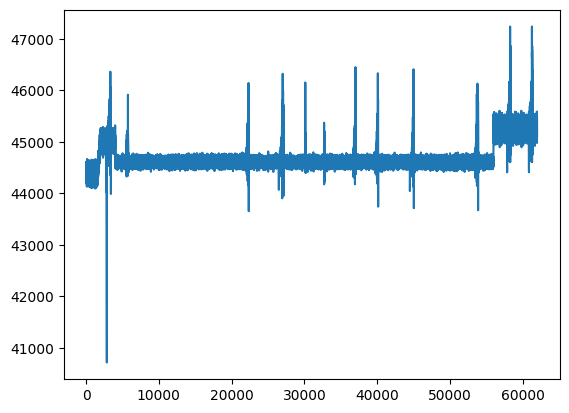

In [ ]:
sub_df.speed.plot()

In [ ]:
from hmm_method import detect_anomalies

pred_labels = detect_anomalies(sub_df.speed.values, window_size=400, stride = 100)

100%|██████████| 616/616 [08:23<00:00,  1.22it/s]


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

true_labels = sub_df.pred_label.values
print(classification_report(true_labels, pred_labels))

              precision    recall  f1-score   support

           0       0.99      0.98      0.99     57426
           1       0.79      0.92      0.85      4574

    accuracy                           0.98     62000
   macro avg       0.89      0.95      0.92     62000
weighted avg       0.98      0.98      0.98     62000



In [ ]:
# Visualising true labels
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='True_Label', line=dict(color='red'), yaxis='y2'))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=pred_labels, mode='lines', name='Pred_Label', line=dict(color='green'), yaxis='y2'))
fig.update_layout(
    yaxis=dict(title='Speed'),
    yaxis2=dict(title='Label',
                overlaying='y',
                side = 'right'),
    xaxis=dict(title='Timesteps')
)
fig.show()

<Axes: >

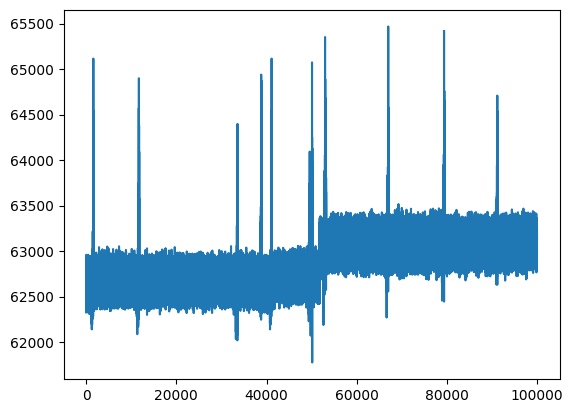

In [ ]:
# First evaluating on a subset
sub_df = pd.read_csv('./data/labelled_data/labelled_9_63.csv')
sub_df.speed.plot()

In [ ]:
pred_labels = detect_anomalies(sub_df.speed.values, window_size=400, stride = 100)

100%|██████████| 996/996 [42:28<00:00,  2.56s/it]


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

true_labels = sub_df.pred_label.values
print(classification_report(true_labels, pred_labels))

              precision    recall  f1-score   support

           0       1.00      0.22      0.36     95695
           1       0.05      1.00      0.10      4305

    accuracy                           0.25    100000
   macro avg       0.53      0.61      0.23    100000
weighted avg       0.96      0.25      0.35    100000



In [ ]:
# Visualising true labels
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='True_Label', line=dict(color='red'), yaxis='y2'))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=pred_labels, mode='lines', name='Pred_Label', line=dict(color='green'), yaxis='y2'))
fig.update_layout(
    yaxis=dict(title='Speed'),
    yaxis2=dict(title='Label',
                overlaying='y',
                side = 'right'),
    xaxis=dict(title='Timesteps')
)
fig.show()

<Axes: >

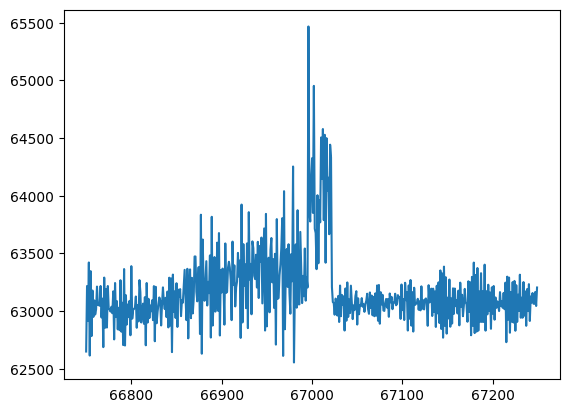

In [ ]:
sub_df.speed.iloc[int(66.75e3):int(67.25e3)].plot()

### HMM Method Failure Inspection

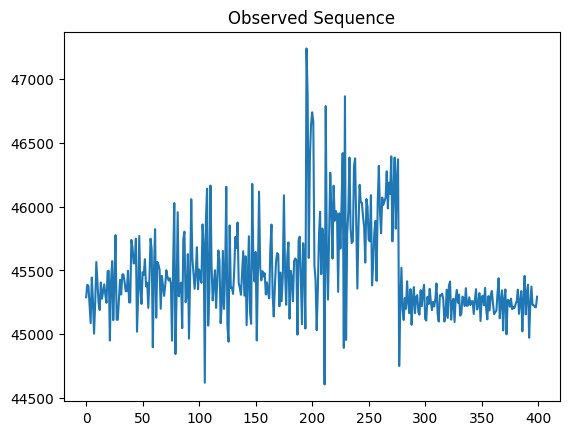

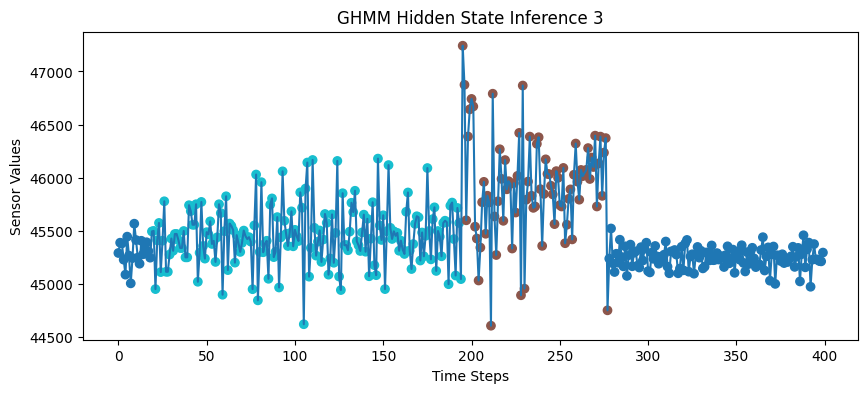

In [ ]:
from hmmlearn.hmm import GaussianHMM, PoissonHMM, CategoricalHMM, MultinomialHMM
from hmmlearn.vhmm import VariationalCategoricalHMM, VariationalGaussianHMM

sub_df = all_dfs[0]
obs = sub_df.speed.iloc[int(61.1e3):int(61.5e3)].values
obs = obs.reshape(-1, 1)

plt.plot(obs)
plt.title("Observed Sequence")
plt.show()

def fit_hmm(obs, model):

    bics = []
    models = []

    for n in range(1, 5):
        best_ll = None
        best_model = None
        try:
          for i in range(10):
            if model == 'G':
              h = GaussianHMM(n, n_iter = 1000, random_state = i)
            elif model == 'P':
              h = PoissonHMM(n, n_iter = 1000, random_state = i)
            h.fit(obs)
            score = h.score(obs)
            if not best_ll or (score > best_ll):
                best_ll = score
                best_model = h
        except:
          continue

        bics.append(best_model.bic(obs))
        models.append(best_model)

    best_index = np.argmin(bics)
    final_model = models[best_index]

    return final_model

def g_or_p(obs, ghmm, phmm):
  pscore = phmm.score(obs)
  gscore = ghmm.score(obs)

  # if gscore < pscore:
  # return phmm.n_components, phmm.predict(obs), 'P'
  # else:
  return ghmm.n_components, ghmm.predict(obs), 'G'

def fit_and_plot(obs):
  obs = obs.reshape(-1,1)
  num_states, hidden_states, M = g_or_p(obs, fit_hmm(obs, 'G'), fit_hmm(obs, 'P'))
  # Plot hidden states
  plt.figure(figsize=(10, 4))
  plt.plot(obs, label="Observations")
  plt.scatter(np.arange(len(obs)), obs, c=hidden_states, cmap="tab10", label="Hidden states")
  plt.title(f"{M}HMM Hidden State Inference {num_states}")
  # plt.legend()
  plt.xlabel("Time Steps")
  plt.ylabel("Sensor Values")
  plt.show()

  return hidden_states

hidden_states = fit_and_plot(obs)

In [ ]:
np.isclose(0.001, 0, atol=1e-2)

np.True_

### Linear Regression + HMM

Initial approach of using number of hidden states as decision variable for each window failed in "labelled_9_63.csv", where even for normal sequences GHMM infered multiple hidden states. Our assumption was that the number of hidden states for all normal sequences will be = 1.

**Solution**:

Fit a linear regression model to each window:
* if the slope is close to zero then normal window
* else anomalous window
* Use HMM on anomalous window to detect start and end position.

* **Issue**: Choosing between GaussianHMM and PoissonHMM for each anomalous window. When data distribution changes e.g. after timestep 56k in "labelled_0_44.csv", GaussianHMM fails to separate hidden states effectively
* **Possible Solution**: Change Point Detection Algorithm

In [ ]:
from hmm_method import _create_windows, _fit_hmm
from tqdm import tqdm
from sklearn.linear_model import LinearRegression

In [ ]:
sub_df = all_dfs[11]
obs = sub_df.speed.values
windows, indices = _create_windows(obs, 400, 100)
anomalies = np.zeros(len(obs))
coefs = []
breakage_start = False
breakage_start_index = None

for i in tqdm(range(1, len(windows))):
  lr = LinearRegression()
  obs = windows[i].reshape(-1,1)
  lr.fit(np.arange(obs.shape[0]).reshape(-1, 1), obs)
  coefs.append(lr.coef_[0][0])

  is_normal = np.isclose(lr.coef_[0][0], 0, atol=1e-1)

  if not is_normal and not breakage_start:
    _, hidden_states = _fit_hmm(obs, 'P')
    trans_indices = np.where((hidden_states[1:] - hidden_states[:-1]) != 0)[0]
    if trans_indices.size > 0:
      breakage_start = True
      breakage_start_index = indices[i][0] + trans_indices[0]

  elif breakage_start and is_normal:
    # Use previous window to determine breakage end
    prev_obs = windows[i-1].reshape(-1,1)
    _, prev_hidden_states =  _fit_hmm(prev_obs, 'P')
    trans_indices = np.where((prev_hidden_states[1:] - prev_hidden_states[:-1]) != 0)[0]
    if trans_indices.size > 0:
      breakage_end_index = indices[i - 1][0] + trans_indices[-1]
      anomalies[breakage_start_index:breakage_end_index] = 1
      breakage_start = False
      breakage_start_index = None

  1%|          | 8/996 [00:05<11:18,  1.46it/s]


KeyboardInterrupt: 

<Axes: >

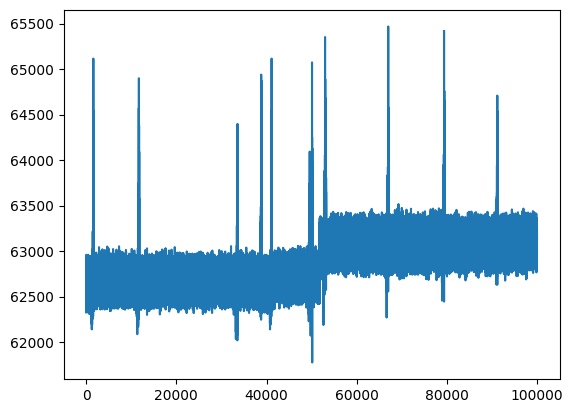

In [ ]:
sub_df.speed.plot()

<Axes: ylabel='Density'>

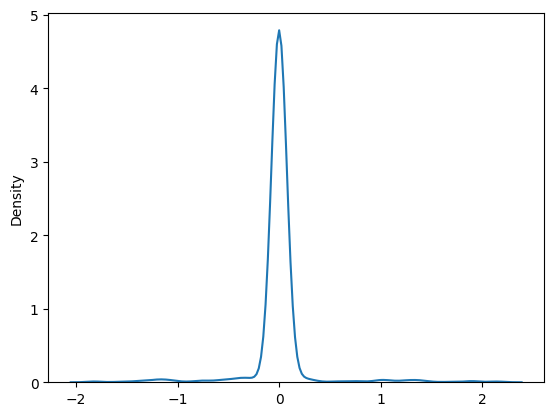

In [ ]:
import seaborn as sns

sns.kdeplot(coefs)

In [ ]:
# Visualising true labels
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='True_Label', line=dict(color='red'), yaxis='y2'))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=anomalies, mode='lines', name='Pred_Label', line=dict(color='green'), yaxis='y2'))
fig.update_layout(
    yaxis=dict(title='Speed'),
    yaxis2=dict(title='Label',
                overlaying='y',
                side = 'right'),
    xaxis=dict(title='Timesteps')
)
fig.show()

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

true_labels = sub_df.pred_label.values
print(classification_report(true_labels, anomalies))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99     95695
           1       0.92      0.45      0.61      4305

    accuracy                           0.97    100000
   macro avg       0.95      0.73      0.80    100000
weighted avg       0.97      0.97      0.97    100000



### LR + Change Point Detection

In [ ]:
%%capture
!pip install ruptures

In [ ]:
sub_df = all_dfs[0]
data = sub_df.speed.values
windows, indices = _create_windows(data, 400, 100)
anomalies = np.zeros(len(data))
coefs = []
breakage_start = False
breakage_start_index = None

for i in tqdm(range(1, len(windows))):
  lr = LinearRegression()
  obs = windows[i].reshape(-1,1)
  lr.fit(np.arange(obs.shape[0]).reshape(-1, 1), obs)
  coefs.append(lr.coef_[0][0])

  is_normal = np.isclose(0, lr.coef_[0][0], atol=3e-1)

  if not is_normal:
    anomalies[indices[i]] = 1

100%|██████████| 616/616 [00:00<00:00, 1006.30it/s]


In [ ]:
# Visualising true labels
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='True_Label', line=dict(color='red'), yaxis='y2'))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=anomalies, mode='lines', name='Pred_Label', line=dict(color='green'), yaxis='y2'))
fig.update_layout(
    yaxis=dict(title='Speed'),
    yaxis2=dict(title='Label',
                overlaying='y',
                side = 'right'),
    xaxis=dict(title='Timesteps')
)
fig.show()

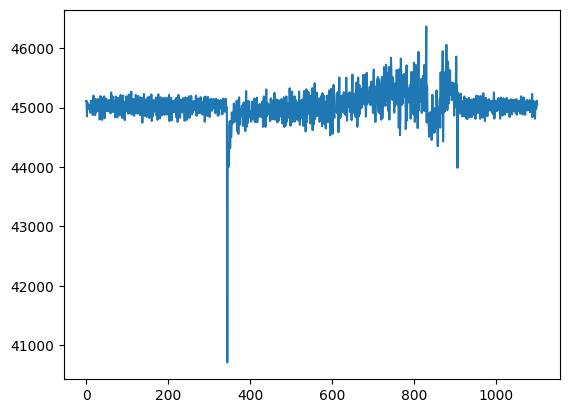

In [ ]:
start_indices = np.where(np.diff(anomalies) == 1)[0]
end_indices = np.where(np.diff(anomalies) == -1)[0]

counter = 0
events = np.zeros(len(data))

for i in range(len(start_indices)):
  events[start_indices[i]:end_indices[i]] = counter+1
  counter += 1

event = data[np.where(events==2)[0]]
plt.plot(event)
# fit_and_plot(event)

In [ ]:
np.unique(events)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15.])

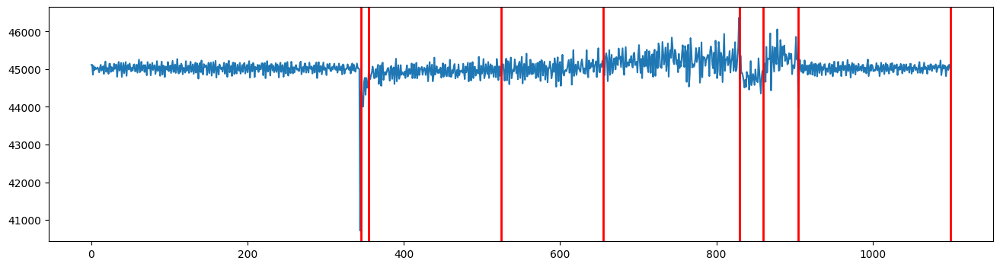

In [ ]:
import ruptures as rpt

def detect_change_points(obs):
  detector = rpt.Pelt(model="rbf").fit(obs)
  change_points = detector.predict(pen=5)

  return change_points

change_points = detect_change_points(event)

plt.figure(figsize=(16,4))
plt.plot(range(len(event)), event)
for x in change_points:
    plt.axvline(x, lw=2, color='red')

plt.show()

Analysing average breakage arrival duration

In [ ]:
sub_df = all_dfs[11]

sub_df.head()

,speed,indo_time,arrival,pred_label
0,62519,2024-09-06 08:30:41+07:00,0,0
1,62897,2024-09-06 08:30:42+07:00,0,0
2,62323,2024-09-06 08:30:43+07:00,0,0
3,62798,2024-09-06 08:30:44+07:00,0,0
4,62558,2024-09-06 08:30:45+07:00,0,0


<Figure size 640x480 with 0 Axes>

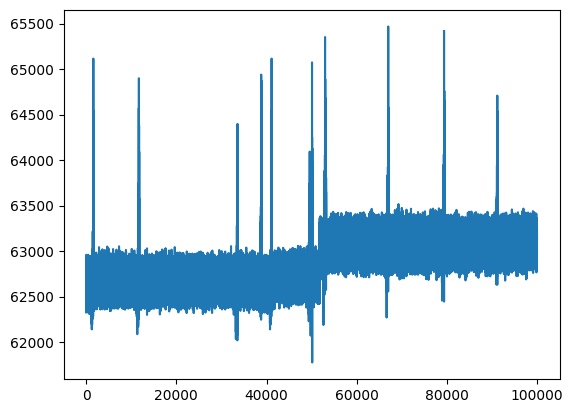

<Figure size 640x480 with 0 Axes>

In [ ]:
sub_df.speed.plot()
plt.figure()

In [ ]:
event = np.zeros(len(sub_df))
start_indices = np.where(sub_df.arrival.diff().dropna().values==1)[0]
end_indices = np.where(sub_df.arrival.diff().dropna().values==-1)[0]

counter = 0

for i in range(len(start_indices)):
  event[start_indices[i]:end_indices[i]] = counter+1
  counter += 1

sub_df['event'] = event
sub_df.groupby('event')['arrival'].count().iloc[1:].values.mean()

np.float64(43.18181818181818)

### Testing LR + Change Point Detection:

1. Multiple datasets with transitions
2. Using CLIP model to classify transition and breakage.
3. Categorising breakage types with number of change points.

#### CLIP

In [ ]:
%%capture
!pip install open_clip_torch transformers

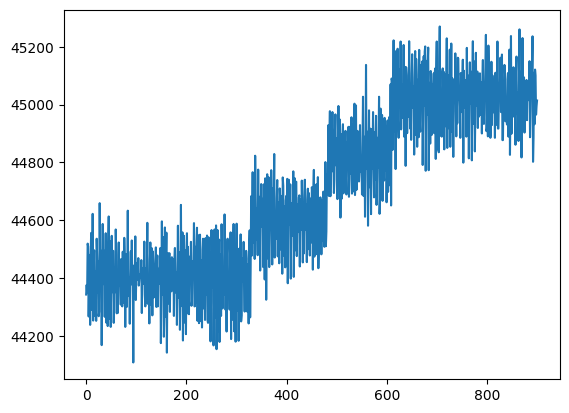

In [ ]:
# Using CLIP on plots of all the events and classifiying them as breakage or transition

# Testing on first plot
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

# Save plot of 1st event
event1 = data[np.where(events==1)[0]]
event2 = data[np.where(events==2)[0]]

# Create your plot
plt.plot(event1)
# Save plot to a BytesIO buffer
buf = BytesIO()
plt.savefig(buf, format='png', bbox_inches='tight')  # tight layout removes excess whitespace
plt.close()
# Load the image from buffer using PIL
buf.seek(0)
img1 = Image.open(buf)
img1

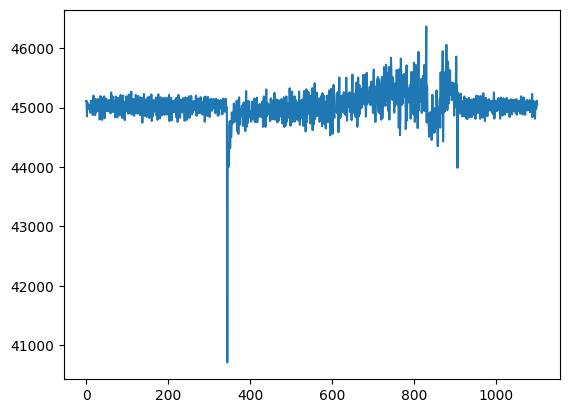

In [ ]:
# Create your plot
plt.plot(event2)
# Save plot to a BytesIO buffer
buf = BytesIO()
plt.savefig(buf, format='png', bbox_inches='tight')  # tight layout removes excess whitespace
plt.close()
# Load the image from buffer using PIL
buf.seek(0)
img2 = Image.open(buf)
img2

In [ ]:
original_images = [img1, img2]

In [ ]:
# First generating captions for an event using CoCa (Contrastive Captioning)
import open_clip
import torch

model, _, transform = open_clip.create_model_and_transforms(
  model_name="coca_ViT-L-14",
  pretrained="mscoco_finetuned_laion2B-s13B-b90k"
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning:


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.



open_clip_pytorch_model.bin:   0%|          | 0.00/2.55G [00:00<?, ?B/s]

In [ ]:
im = transform(img).unsqueeze(0)

with torch.no_grad(), torch.amp.autocast('cuda'):
  generated = model.generate(im)

print(open_clip.decode(generated[0]).split("<end_of_text>")[0].replace("<start_of_text>", ""))

a line graph of a plot of data . the data is very high . 


In [ ]:
# CLIP (Contrastive Language Image Pretraining)
model, _, preprocess = open_clip.create_model_and_transforms('convnext_base_w', pretrained='laion2b_s13b_b82k_augreg')
model.eval()
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


open_clip_model.safetensors:   0%|          | 0.00/718M [00:00<?, ?B/s]

Model parameters: 179,385,345
Context length: 77
Vocab size: 49408


In [ ]:
preprocess

Compose(
    Resize(size=256, interpolation=bicubic, max_size=None, antialias=True)
    CenterCrop(size=(256, 256))
    <function _convert_to_rgb at 0x77fba8e64900>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

In [ ]:
from open_clip import tokenizer
tokenizer.tokenize("Hello World!")

tensor([[49406,  3306,  1002,   256, 49407,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0]])

In [ ]:
import os
import skimage
import IPython.display
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

from collections import OrderedDict
import torch

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

descriptions = {
    "transition_plot": "a time series plot with a scale shift",
    "anomaly_plot": "a time series plot showing an anomalous subsequence",
}

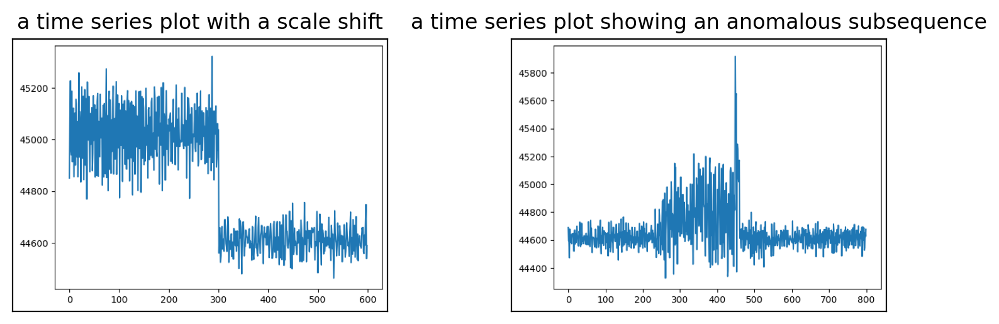

In [ ]:
images = []
texts = []
plt.figure(figsize=(16, 5))

for i, img in enumerate(original_images):

    plt.subplot(2, 4, len(images) + 1)
    plt.imshow(img)
    plt.title(f"{list(descriptions.values())[i]}")
    plt.xticks([])
    plt.yticks([])

    images.append(preprocess(img))
    texts.append(list(descriptions.values())[i])

plt.tight_layout()

##### Building features

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

In [ ]:
image_input = torch.tensor(np.stack(images))
text_tokens = tokenizer.tokenize(["This is " + desc for desc in texts])

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

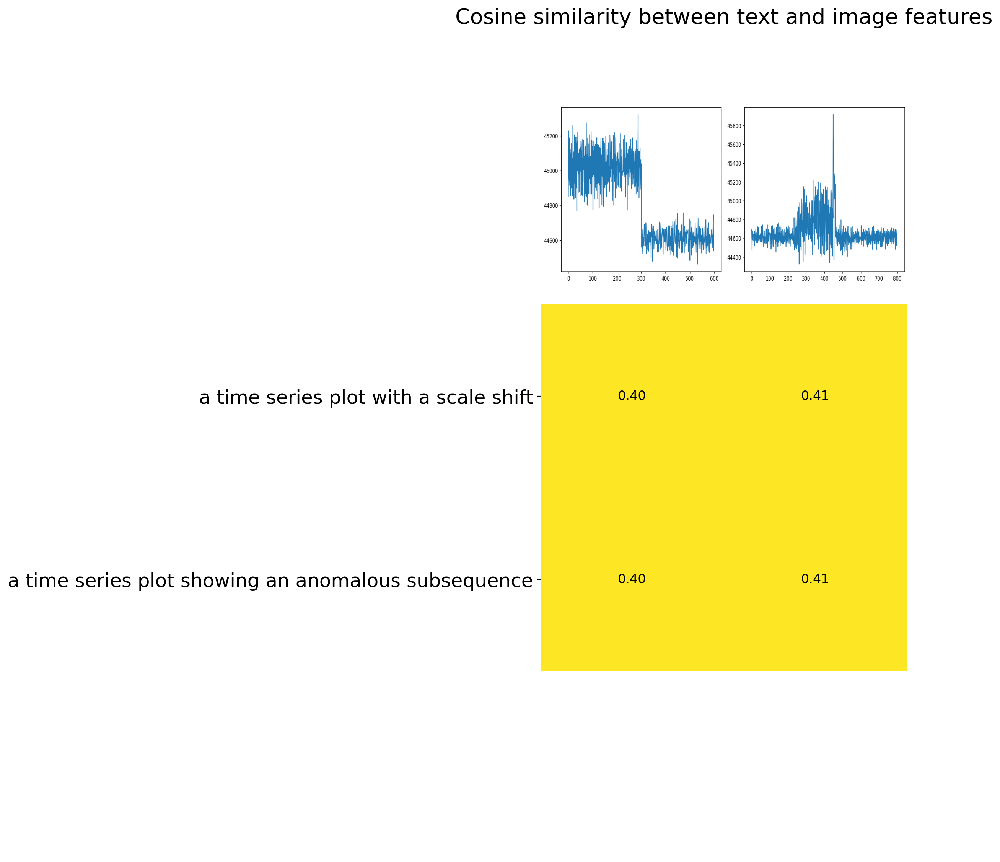

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

#### Extracting and inspecting features

For transition and anomalous sequences

In [ ]:
%%capture
!pip install tsfresh

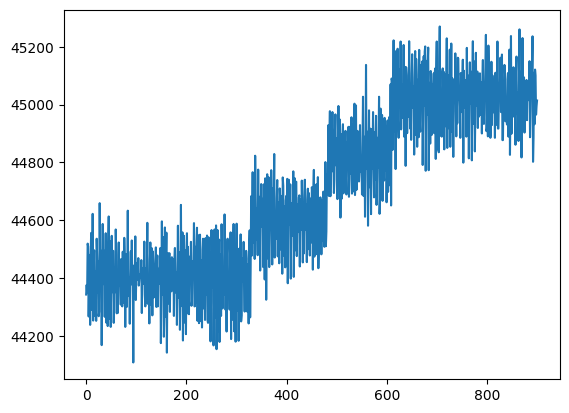

In [ ]:
plt.plot(event1)

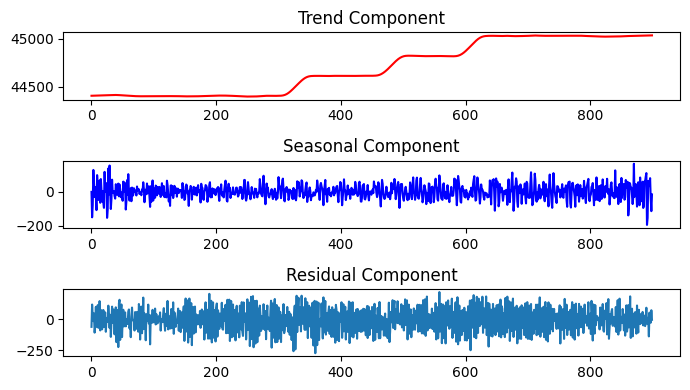

In [ ]:
# perform stl on the above series
# Perform STL decomposition
from statsmodels.tsa.seasonal import STL

def plot_stl(event: np.array):
  stl = STL(event, period=30)
  result = stl.fit()

  fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(7, 4))

  x = range(len(event))
  ax1.plot(x, result.trend, label='Trend', color='red')
  ax1.set_title('Trend Component')
  ax2.plot(x, result.seasonal, label='Seasonal', color='blue')
  ax2.set_title('Seasonal Component')
  ax3.plot(x, result.resid, label='Residual')
  ax3.set_title('Residual Component')
  plt.tight_layout()
  plt.show()

  return result

result = plot_stl(event1)

In [ ]:
np.diff(result.trend).sum()

np.float64(628.6111365958204)

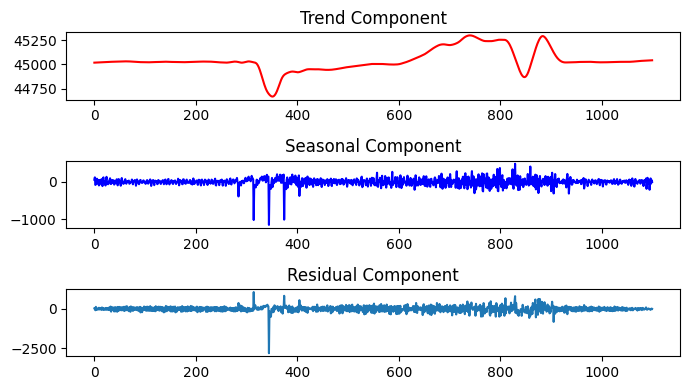

In [ ]:
result2 = plot_stl(event2)

In [ ]:
np.diff(result2.trend).sum()

np.float64(24.45098484383925)

'anomaly'

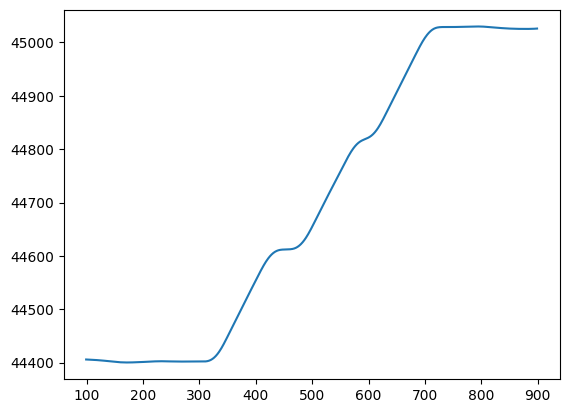

In [ ]:
import numpy as np

def classify_trend_pattern(trend: np.ndarray, slope_window: int = 100, change_thresh: int = 5) -> str:
  """
  Classify trend pattern as 'scale_shift' or 'anomaly' based on slope behavior.

  Parameters:
  - trend: np.ndarray, trend component of the time series
  - slope_window: int, window size for smoothing and computing local slope
  - change_thresh: int, number of allowed slope sign changes before flagging as anomaly

  Returns:
  - str: 'scale_shift' or 'anomaly'
  """

  slope = np.diff(trend)
  slope_sign = np.sign(slope)
  # Count the number of times the slope sign changes
  sign_changes = np.sum(np.diff(slope_sign[slope_sign != 0]) != 0)

  # Classify based on threshold
  if sign_changes > change_thresh:
    return 'anomaly'
  else:
    return 'scale_shift'

classify_trend_pattern(result.trend)

#### LR + Change Point Detection (Function)

In [ ]:
def detect_anomalies(data):
  windows, indices = _create_windows(data, 400, 100)
  anomalies = np.zeros(len(data))
  event_pred_labels = np.zeros(len(data))
  arrival_pred_labels = np.zeros(len(data))
  str_arr = []
  coefs = []
  breakage_start = False
  brk_str_i = None

  for i in tqdm(range(1, len(windows))):
    obs = windows[i]
    lr = LinearRegression()
    obs = obs.reshape(-1,1)
    lr.fit(np.arange(obs.shape[0]).reshape(-1, 1), obs)
    coefs.append(lr.coef_[0][0])

    is_normal = np.isclose(0, lr.coef_[0][0], atol=3e-1)

    if not is_normal:
      anomalies[indices[i]] = 1

      if not breakage_start:
        # Start of a new breakage event
        breakage_start = True
        brk_str_i = indices[i][0]
    elif np.sum(anomalies[indices[i]]) == 0:
      if breakage_start:
        # End of breakage event
        brk_end_i = indices[i - 1][-300]
        breakage_start = False

        # Post-process the breakage window
        breakage_window = data[brk_str_i:brk_end_i + 1]

        change_points = detect_change_points(breakage_window)

        if len(change_points) >= 3:
          brk_end = change_points[-2]
          brk_arrival = change_points[-3]
          brk_str = change_points[0]
          event_pred_labels[brk_str_i + brk_str : brk_str_i + brk_end] = 1
          arrival_pred_labels[brk_str_i + brk_arrival : brk_str_i + brk_end] = 1
          str_arr.append((brk_str_i + brk_str, brk_str_i + brk_arrival))


        brk_str_i = None


  if breakage_start:
    brk_end_i = indices[-1][-1]  # last index in the data
    breakage_window = data[brk_str_i:brk_end_i + 1]

    change_points = detect_change_points(breakage_window)

    if len(change_points) >= 3:
      brk_end = change_points[-2]
      brk_arrival = change_points[-3]
      brk_str = change_points[0]
      event_pred_labels[brk_str_i + brk_str : brk_str_i + brk_end] = 1
      arrival_pred_labels[brk_str_i + brk_arrival : brk_str_i + brk_end] = 1
      str_arr.append((brk_str_i + brk_str, brk_str_i + brk_arrival))


  return anomalies, str_arr, event_pred_labels, arrival_pred_labels

#### LR + Acc



In [ ]:
def detect_anomalies_acc(data):
  windows, indices = _create_windows(data, 400, 100)
  anomalies = np.zeros(len(data))
  event_pred_labels = np.zeros(len(data))
  arrival_pred_labels = np.zeros(len(data))
  str_arr = []
  coefs = []
  breakage_start = False
  brk_str_i = None

  for i in tqdm(range(1, len(windows))):
    obs = windows[i]
    lr = LinearRegression()
    obs = obs.reshape(-1,1)
    lr.fit(np.arange(obs.shape[0]).reshape(-1, 1), obs)
    coefs.append(lr.coef_[0][0])

    is_normal = np.isclose(0, lr.coef_[0][0], atol=3e-1)

    if not is_normal:
      anomalies[indices[i]] = 1

      if not breakage_start:
        # Start of a new breakage event
        breakage_start = True
        brk_str_i = indices[i][0]
    elif np.sum(anomalies[indices[i]]) == 0:
      if breakage_start:
        # End of breakage event
        brk_end_i = indices[i - 1][-300]
        breakage_start = False

        # Post-process the breakage window
        breakage_window = data[brk_str_i:brk_end_i + 1]

        change_points = detect_change_points(breakage_window)
        acc = [breakage_window[i] - breakage_window[i-2] for i in range(2, len(breakage_window))]
        brk_str = change_points[0]
        brk_arrival = np.where(acc == np.max(acc))[0][0]
        brk_end = change_points[-2]
        event_pred_labels[brk_str_i + brk_str : brk_str_i + brk_end] = 1
        arrival_pred_labels[brk_str_i + brk_arrival : brk_str_i + brk_end] = 1
        str_arr.append((brk_str_i + brk_str, brk_str_i + brk_arrival))
        brk_str_i = None


  if breakage_start:
    brk_end_i = indices[-1][-1]  # last index in the data
    breakage_window = data[brk_str_i:brk_end_i + 1]

    change_points = detect_change_points(breakage_window)

    # Post-process the breakage window
    breakage_window = data[brk_str_i:brk_end_i + 1]

    change_points = detect_change_points(breakage_window)
    acc = [breakage_window[i] - breakage_window[i-2] for i in range(2, len(breakage_window))]
    brk_end = change_points[-2]
    brk_arrival = np.where(acc == np.max(acc))[0][0]
    brk_str = change_points[0]
    event_pred_labels[brk_str_i + brk_str : brk_str_i + brk_end] = 1
    arrival_pred_labels[brk_str_i + brk_arrival : brk_str_i + brk_end] = 1
    str_arr.append((brk_str_i + brk_str, brk_str_i + brk_arrival))
    brk_str_i = None


  return anomalies, str_arr, event_pred_labels, arrival_pred_labels

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
from typing import Callable, Tuple, List

def predict_and_evaluate_method(
    df: pd.DataFrame,
    method: Callable[[np.ndarray], Tuple[np.ndarray, np.ndarray, np.ndarray, np.ndarray]]
) -> Tuple[np.ndarray, List]:
  '''
  Evaluates the LR + ChangePointMethod on df

  Prints classification report for complete event and arrival events.
  '''

  data = df.speed.values
  anomalies, str_arr, event_pred_labels, arrival_pred_labels = method(data)

  event_true_labels = df.pred_label.values
  print("-------------------------------------\nComplete Event:\n", classification_report(event_true_labels, event_pred_labels),"\n----------------")

  arrival_true_labels = df.arrival.values
  print("--------------------------------------\nArrival Event:\n", classification_report(arrival_true_labels, arrival_pred_labels),"\n-------------")

  return anomalies, str_arr, event_pred_labels, arrival_pred_labels

sub_df = all_dfs[0]
anomalies, str_arr, event_pred_labels, arrival_pred_labels = predict_and_evaluate_method(sub_df, detect_anomalies)

100%|██████████| 616/616 [00:06<00:00, 88.01it/s]


-------------------------------------
Complete Event:
               precision    recall  f1-score   support

           0       0.98      0.99      0.99     57426
           1       0.93      0.80      0.86      4574

    accuracy                           0.98     62000
   macro avg       0.95      0.90      0.92     62000
weighted avg       0.98      0.98      0.98     62000
 
----------------
--------------------------------------
Arrival Event:
               precision    recall  f1-score   support

           0       1.00      0.99      1.00     61197
           1       0.67      0.89      0.77       803

    accuracy                           0.99     62000
   macro avg       0.84      0.94      0.88     62000
weighted avg       0.99      0.99      0.99     62000
 
-------------


In [ ]:
def plot_labels(sub_df, event_pred_labels, arrival_pred_labels, anomalies, str_arr):
  fig = go.Figure()

  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue'), opacity = 0.6))
  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='Event_True_Label', line=dict(color='green'), yaxis='y2', opacity = 0.6))
  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=event_pred_labels, mode='lines', name='Event_Pred_Label', line=dict(color='purple'), yaxis='y2', opacity = 0.6))
  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.arrival.values, mode='lines', name='Arrival_True_Label', line=dict(color='orange'), yaxis='y2', opacity = 0.6))
  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=arrival_pred_labels, mode='lines', name='Arrival_Pred_Label', line=dict(color='grey'), yaxis='y2', opacity = 0.6))
  fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=anomalies, mode='lines', name='LinRegLabel', line=dict(color='deeppink'), yaxis='y2', opacity = 0.6))

  for idx in str_arr:
      fig.add_shape(
          type="line",
          x0=idx[1], x1=idx[1],
          y0=0, y1=1,
          xref='x',
          yref='paper',
          line=dict(color="red", width=2, dash="dash"),
          line_color = "rgba(255, 0, 0, 0.6)",

      )
      fig.add_shape(
          type="line",
          x0=idx[0], x1=idx[0],
          y0=0, y1=1,
          xref='x',
          yref='paper',
          line=dict(color="yellow", width=2, dash="dash"),
          line_color = "rgba(255, 255, 0, 0.6)",
      )

  fig.add_trace(go.Scatter(
      x=[None],
      y=[None],
      mode='lines',
      line=dict(color="red", width=2, dash="dash"),
      name='Breakage Arrival'
  ))

  fig.add_trace(go.Scatter(
      x=[None],
      y=[None],
      mode='lines',
      line=dict(color="yellow", width=2, dash="dash"),
      name='Breakage Start'
  ))

  fig.update_layout(
      yaxis=dict(title='Speed'),
      yaxis2=dict(
          title='Label',
          overlaying='y',
          side='right'
      ),
      xaxis=dict(title='Timesteps')
  )

  fig.show()

plot_labels(sub_df, event_pred_labels, arrival_pred_labels, anomalies, str_arr)

In [ ]:
sub_df = all_dfs[11]
anomalies, str_arr, event_pred_labels, arrival_pred_labels = predict_and_evaluate_method(sub_df, detect_anomalies)

100%|██████████| 996/996 [00:05<00:00, 184.41it/s]

-------------------------------------
Complete Event:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     95695
           1       0.91      0.93      0.92      4305

    accuracy                           0.99    100000
   macro avg       0.95      0.96      0.96    100000
weighted avg       0.99      0.99      0.99    100000
 
----------------
--------------------------------------
Arrival Event:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     99525
           1       0.82      0.81      0.82       475

    accuracy                           1.00    100000
   macro avg       0.91      0.91      0.91    100000
weighted avg       1.00      1.00      1.00    100000
 
-------------


In [ ]:
plot_labels(sub_df, event_pred_labels, arrival_pred_labels, anomalies, str_arr)

#### Testing on Latest Data

In [ ]:
sub_df = pd.read_csv('./data/latest_data.csv', usecols=["A2:MCPGSpeed"])
sub_df.rename(columns={"A2:MCPGSpeed": "speed"}, inplace=True)
sub_df.head()

,speed
0,32582.9
1,32585.6
2,32566.0
3,32574.6
4,32601.6


<Axes: >

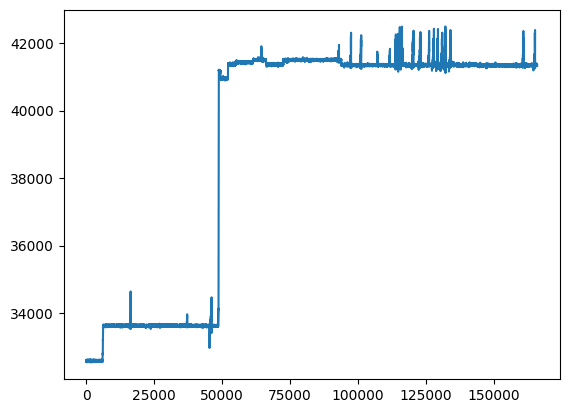

In [ ]:
sub_df.speed.plot()

In [ ]:
data = sub_df.speed.values
anomalies, str_arr, event_pred_labels, arrival_pred_labels = detect_anomalies_acc(data)

100%|██████████| 1654/1654 [00:08<00:00, 194.77it/s]


In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.speed.values, mode='lines', name='Speed', line=dict(color='blue'), opacity = 0.6))
# fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.pred_label.values, mode='lines', name='Event_True_Label', line=dict(color='green'), yaxis='y2', opacity = 0.6))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=event_pred_labels, mode='lines', name='Event_Pred_Label', line=dict(color='purple'), yaxis='y2', opacity = 0.6))
# fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=sub_df.arrival.values, mode='lines', name='Arrival_True_Label', line=dict(color='orange'), yaxis='y2', opacity = 0.6))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=arrival_pred_labels, mode='lines', name='Arrival_Pred_Label', line=dict(color='grey'), yaxis='y2', opacity = 0.6))
fig.add_trace(go.Scatter(x=list(range(0, len(sub_df))), y=anomalies, mode='lines', name='LinRegLabel', line=dict(color='deeppink'), yaxis='y2', opacity = 0.6))

for idx in str_arr:
    fig.add_shape(
        type="line",
        x0=idx[1], x1=idx[1],
        y0=0, y1=1,
        xref='x',
        yref='paper',
        line=dict(color="red", width=2, dash="dash"),
        line_color = "rgba(255, 0, 0, 0.6)",

    )
    fig.add_shape(
        type="line",
        x0=idx[0], x1=idx[0],
        y0=0, y1=1,
        xref='x',
        yref='paper',
        line=dict(color="yellow", width=2, dash="dash"),
        line_color = "rgba(255, 255, 0, 0.6)",
    )

fig.add_trace(go.Scatter(
    x=[None],
    y=[None],
    mode='lines',
    line=dict(color="red", width=2, dash="dash"),
    name='Breakage Arrival'
))

fig.add_trace(go.Scatter(
    x=[None],
    y=[None],
    mode='lines',
    line=dict(color="yellow", width=2, dash="dash"),
    name='Breakage Start'
))

fig.update_layout(
    yaxis=dict(title='Speed'),
    yaxis2=dict(
        title='Label',
        overlaying='y',
        side='right'
    ),
    xaxis=dict(title='Timesteps')
)

fig.show()

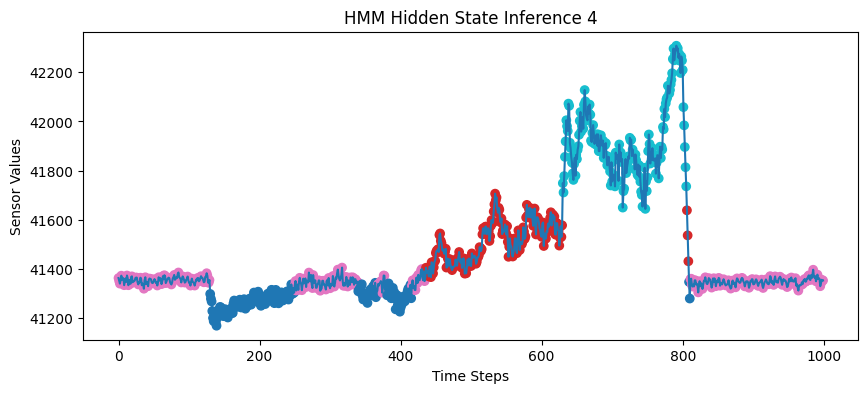

In [ ]:
obs = np.array(data[int(130.2e3):int(131.2e3)])
obs = obs.reshape(-1,1)
def fit_hmm(obs):
  bics = []
  models = []

  for n in range(1, 5):
      best_ll = None
      best_model = None
      for i in range(10):
        h = GaussianHMM(n, n_iter = 1000, random_state = i)
        h.fit(obs)
        score = h.score(obs)
        if not best_ll or (score > best_ll):
          best_ll = score
          best_model = h

      bics.append(best_model.bic(obs))
      models.append(best_model)

  best_index = np.argmin(bics)
  final_model = models[best_index]

  return final_model.n_components, final_model.predict(obs)

num_states, hidden_states = fit_hmm(obs)

plt.figure(figsize=(10, 4))
plt.plot(obs, label="Observations")
plt.scatter(np.arange(len(obs)), obs, c=hidden_states, cmap="tab10", label="Hidden states")
plt.title(f"HMM Hidden State Inference {num_states}")
# plt.legend()
plt.xlabel("Time Steps")
plt.ylabel("Sensor Values")
plt.show()

### Classifying Breakage and Transition

#### FFT

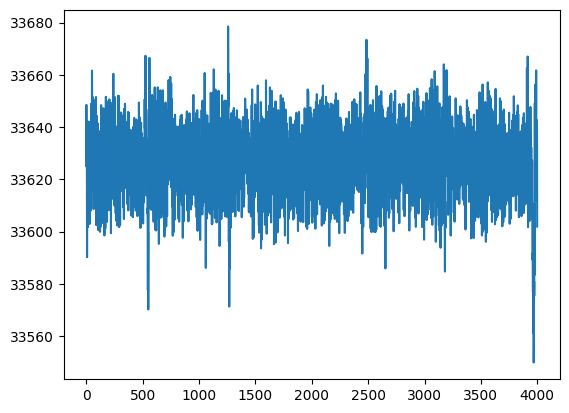

In [ ]:
time_series = data[int(12e3):int(16e3)]
plt.plot(time_series)

Text(0, 0.5, 'Magnitude')

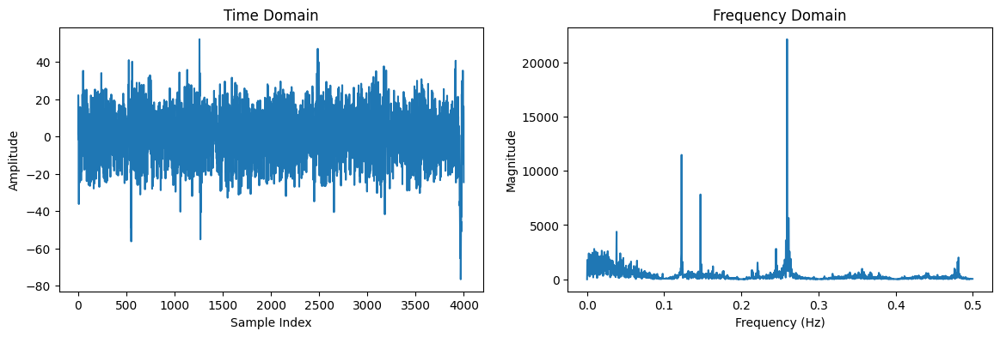

In [ ]:
time_series = time_series - np.mean(time_series)

# FFT
fft_vals = np.fft.fft(time_series)
fft_freqs = np.fft.fftfreq(len(fft_vals), d=1)

# Take positive frequencies
half = len(fft_vals) // 2
frequencies = fft_freqs[:half]
magnitude = np.abs(fft_vals[:half])

# Plot
fig, axs = plt.subplots(1, 2, figsize=(14, 4))

# Time domain
axs[0].plot(time_series)
axs[0].set_title("Time Domain")
axs[0].set_xlabel("Sample Index")
axs[0].set_ylabel("Amplitude")

# Frequency domain
axs[1].plot(frequencies, magnitude)
axs[1].set_title("Frequency Domain")
axs[1].set_xlabel("Frequency (Hz)")
axs[1].set_ylabel("Magnitude")

In [ ]:
anomalies.shape

In [ ]:
start_indices = np.where(np.diff(anomalies) == 1)[0]
end_indices = np.where(np.diff(anomalies) == -1)[0]

counter = 0
events = np.zeros(len(data))

for i in range(len(start_indices)):
  events[start_indices[i]:end_indices[i]] = counter+1
  counter += 1

print(np.unique(events))

event1 = data[np.where(events==1)[0]]
event2 = data[np.where(events==2)[0]]
event3 = data[np.where(events==3)[0]]
event4 = data[np.where(events==11)[0]]

# classify event 5
event5 = data[np.where(events==16)[0]]

[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.
 18. 19. 20. 21. 22. 23. 24. 25. 26.]


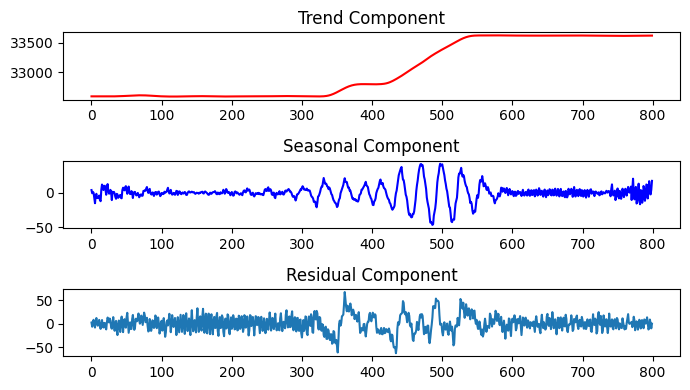

In [ ]:
# STL of event 1 which is a transition
from helper_funcs import plot_stl

# upward transition event
result1 = plot_stl(event1)

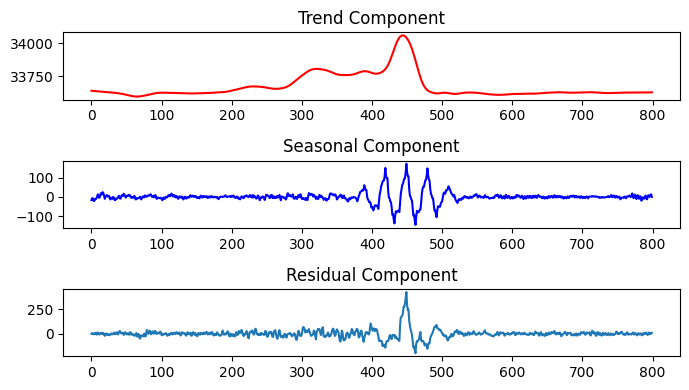

In [ ]:
# most common breakage event
result2 = plot_stl(event2)

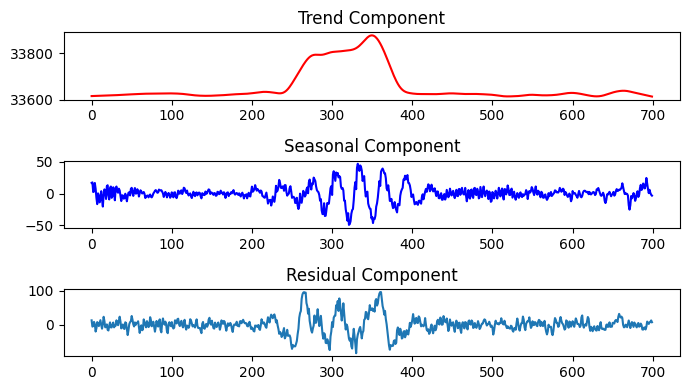

In [ ]:
# sharp rise and drop breakage event
result3 = plot_stl(event3)

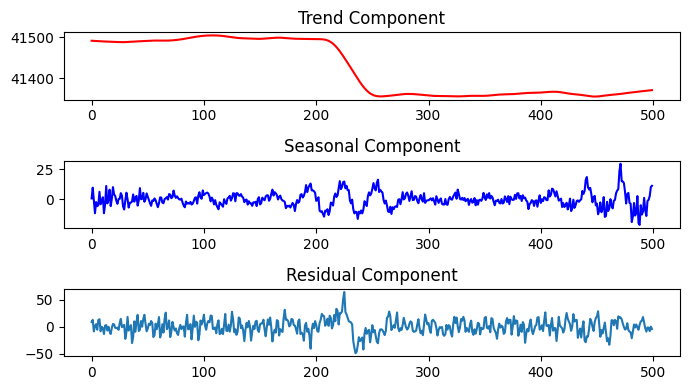

In [ ]:
result4 = plot_stl(event4)

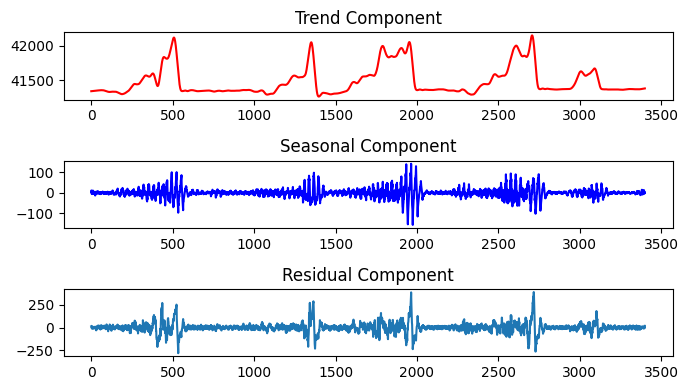

In [ ]:
result5 = plot_stl(event5)

In [ ]:
slope1 = np.diff(result1.trend)/result1.trend[1:]
slope2 = np.diff(result2.trend)/result2.trend[1:]
slope3 = np.diff(result3.trend)/result3.trend[1:]
slope4 = np.diff(result4.trend)/result4.trend[1:]

slope5 = np.diff(result5.trend)/result5.trend[1:]

### Distribution Similarity Test

=== DISTRIBUTION-BASED CLASSIFICATION RESULTS ===
Consensus Classification: Event_2
Confidence: 0.75
Votes: {'Event_2': 3, 'Event_3': 1}

=== INDIVIDUAL METHOD RESULTS ===
KS_TEST: Event_2 (score: 0.0000)
WASSERSTEIN: Event_2 (score: 0.0000)
MANNWHITNEY: Event_3 (score: 0.0028)
HISTOGRAM: Event_2 (score: 0.0009)

=== DISTRIBUTION STATISTICS ===
Target (Slope5):
  mean: 0.0000
  std: 0.0001
  skewness: -2.0569
  kurtosis: 10.0547
  median: 0.0000
  q25: -0.0000
  q75: 0.0000
  iqr: 0.0000
  min: -0.0007
  max: 0.0004
  range: 0.0011

Reference Patterns:
Event_1:
  mean: 0.0000
  std: 0.0001
  skewness: 1.6845
  kurtosis: 1.1961
  median: 0.0000
  q25: -0.0000
  q75: 0.0000
  iqr: 0.0000
  min: -0.0000
  max: 0.0003
  range: 0.0003
Event_2:
  mean: -0.0000
  std: 0.0001
  skewness: -1.4693
  kurtosis: 13.6032
  median: 0.0000
  q25: -0.0000
  q75: 0.0000
  iqr: 0.0000
  min: -0.0006
  max: 0.0005
  range: 0.0010
Event_3:
  mean: -0.0000
  std: 0.0001
  skewness: -1.4663
  kurtosis: 8.203

<ipython-input-210-3e7d41d02150>:207: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



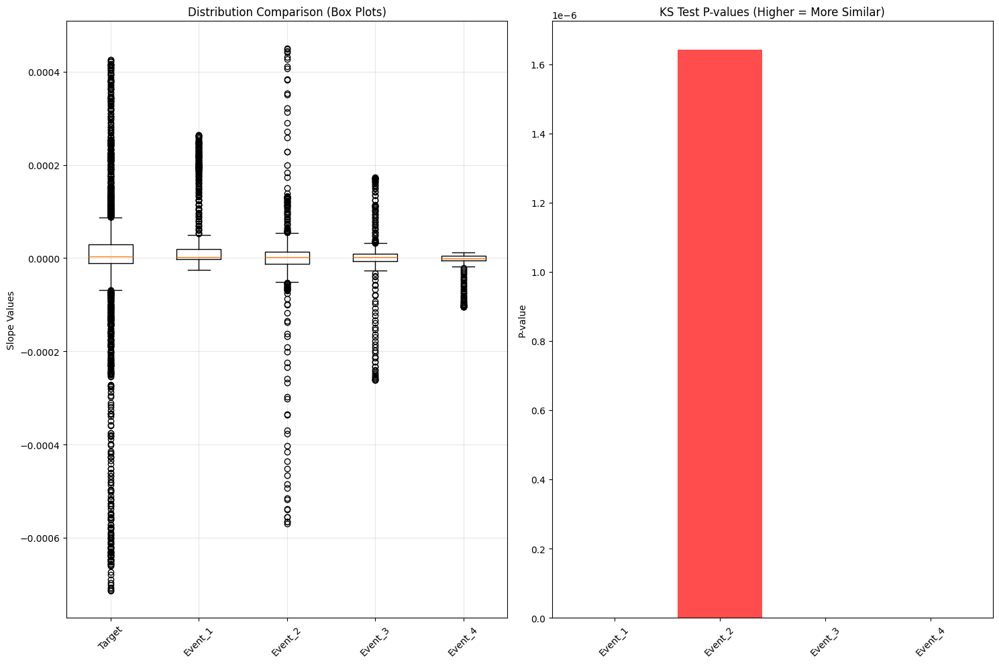

In [ ]:
import numpy as np
from scipy import stats
from scipy.stats import ks_2samp, wasserstein_distance
import matplotlib.pyplot as plt

def calculate_distribution_similarity(target_slopes, reference_slopes_list, method='ks_test'):
    """
    Calculate distribution similarity between target slopes and reference slope patterns

    Parameters:
    target_slopes: numpy array, the slope values to classify
    reference_slopes_list: list of numpy arrays, reference slope patterns
    method: str, method for comparing distributions
            - 'ks_test': Kolmogorov-Smirnov test (lower p-value = more different)
            - 'wasserstein': Wasserstein distance (lower = more similar)
            - 'anderson': Anderson-Darling test
            - 'mannwhitney': Mann-Whitney U test
            - 'histogram': Chi-square test on histograms

    Returns:
    list of similarity scores
    """
    # Clean the target slopes
    target_clean = target_slopes[np.isfinite(target_slopes)]

    similarities = []

    for ref_slopes in reference_slopes_list:
        # Clean reference slopes
        ref_clean = ref_slopes[np.isfinite(ref_slopes)]

        if len(target_clean) == 0 or len(ref_clean) == 0:
            similarities.append(np.inf if method == 'wasserstein' else 0)
            continue

        if method == 'ks_test':
            # Kolmogorov-Smirnov test - higher p-value means more similar distributions
            statistic, p_value = ks_2samp(target_clean, ref_clean)
            similarities.append(p_value)  # Higher p-value = more similar

        elif method == 'wasserstein':
            # Wasserstein distance - lower distance means more similar
            distance = wasserstein_distance(target_clean, ref_clean)
            similarities.append(distance)

        elif method == 'anderson':
            # Anderson-Darling test for same distribution
            try:
                # Combine samples and test if they come from same distribution
                combined = np.concatenate([target_clean, ref_clean])
                n1, n2 = len(target_clean), len(ref_clean)

                # Two-sample Anderson-Darling test approximation
                ranked = stats.rankdata(combined)
                rank1 = ranked[:n1]
                rank2 = ranked[n1:]

                # Calculate test statistic
                N = n1 + n2
                H = (n1 * np.sum((2 * rank1 - N - 1)**2) +
                     n2 * np.sum((2 * rank2 - N - 1)**2)) / (n1 * n2 * N)

                similarities.append(1 / (1 + H))  # Higher = more similar
            except:
                similarities.append(0)

        elif method == 'mannwhitney':
            # Mann-Whitney U test - higher p-value means more similar distributions
            try:
                statistic, p_value = stats.mannwhitneyu(target_clean, ref_clean,
                                                       alternative='two-sided')
                similarities.append(p_value)
            except:
                similarities.append(0)

        elif method == 'histogram':
            # Chi-square test on histograms
            try:
                # Create histograms with same bins
                min_val = min(np.min(target_clean), np.min(ref_clean))
                max_val = max(np.max(target_clean), np.max(ref_clean))
                bins = np.linspace(min_val, max_val, 20)

                hist1, _ = np.histogram(target_clean, bins=bins, density=True)
                hist2, _ = np.histogram(ref_clean, bins=bins, density=True)

                # Add small constant to avoid division by zero
                hist1 = hist1 + 1e-10
                hist2 = hist2 + 1e-10

                # Chi-square test
                chi2_stat = np.sum((hist1 - hist2)**2 / (hist1 + hist2))
                similarities.append(1 / (1 + chi2_stat))  # Higher = more similar
            except:
                similarities.append(0)

    return similarities

def calculate_distribution_stats(slopes):
    """Calculate comprehensive distribution statistics"""
    clean_slopes = slopes[np.isfinite(slopes)]

    if len(clean_slopes) == 0:
        return {
            'mean': np.nan, 'std': np.nan, 'skewness': np.nan, 'kurtosis': np.nan,
            'median': np.nan, 'q25': np.nan, 'q75': np.nan, 'iqr': np.nan,
            'min': np.nan, 'max': np.nan, 'range': np.nan
        }

    return {
        'mean': np.mean(clean_slopes),
        'std': np.std(clean_slopes),
        'skewness': stats.skew(clean_slopes),
        'kurtosis': stats.kurtosis(clean_slopes),
        'median': np.median(clean_slopes),
        'q25': np.percentile(clean_slopes, 25),
        'q75': np.percentile(clean_slopes, 75),
        'iqr': np.percentile(clean_slopes, 75) - np.percentile(clean_slopes, 25),
        'min': np.min(clean_slopes),
        'max': np.max(clean_slopes),
        'range': np.max(clean_slopes) - np.min(clean_slopes)
    }

def classify_slope_distribution(slope5, slope_patterns, pattern_labels=None, methods=None):
    """
    Classify slope5 by finding the most similar distribution among slope_patterns

    Parameters:
    slope5: numpy array, the slope to classify
    slope_patterns: list of numpy arrays, reference slope patterns
    pattern_labels: list of strings, labels for each pattern
    methods: list of strings, distribution comparison methods to use

    Returns:
    dict with classification results
    """
    if pattern_labels is None:
        pattern_labels = [f"Event_{i+1}" for i in range(len(slope_patterns))]

    if methods is None:
        methods = ['ks_test', 'wasserstein', 'mannwhitney']

    results = {
        'distribution_stats': {},
        'similarity_scores': {},
        'classifications': {},
        'consensus_classification': None
    }

    # Calculate distribution statistics for all slopes
    results['distribution_stats']['target'] = calculate_distribution_stats(slope5)
    for i, (pattern, label) in enumerate(zip(slope_patterns, pattern_labels)):
        results['distribution_stats'][label] = calculate_distribution_stats(pattern)

    # Calculate similarities using different methods
    votes = {}
    for method in methods:
        similarities = calculate_distribution_similarity(slope5, slope_patterns, method)
        results['similarity_scores'][method] = dict(zip(pattern_labels, similarities))

        # Determine best match based on method
        if method in ['ks_test', 'mannwhitney', 'anderson', 'histogram']:
            # Higher score = more similar
            best_idx = np.argmax(similarities)
        else:  # wasserstein
            # Lower score = more similar
            best_idx = np.argmin(similarities)

        best_match = pattern_labels[best_idx]
        results['classifications'][method] = {
            'best_match': best_match,
            'score': similarities[best_idx]
        }

        # Vote counting for consensus
        if best_match not in votes:
            votes[best_match] = 0
        votes[best_match] += 1

    # Consensus classification
    consensus_match = max(votes.keys(), key=lambda k: votes[k])
    results['consensus_classification'] = {
        'best_match': consensus_match,
        'votes': votes,
        'confidence': votes[consensus_match] / len(methods)
    }

    return results

def plot_distribution_comparison(slope5, slope_patterns, pattern_labels, results):
    """Plot distribution comparison"""
    fig, axes = plt.subplots(1, 2, figsize=(15, 10))

    slope5_clean = slope5[np.isfinite(slope5)]

    # Plot 2: Box plots
    ax2 = axes[0]
    data_for_box = [slope5_clean]
    labels_for_box = ['Target']

    for pattern, label in zip(slope_patterns, pattern_labels):
        pattern_clean = pattern[np.isfinite(pattern)]
        if len(pattern_clean) > 0:
            data_for_box.append(pattern_clean)
            labels_for_box.append(label)

    ax2.boxplot(data_for_box, labels=labels_for_box)
    ax2.set_title('Distribution Comparison (Box Plots)')
    ax2.set_ylabel('Slope Values')
    ax2.tick_params(axis='x', rotation=45)
    ax2.grid(True, alpha=0.3)

    # Plot 3: KS Test Results
    ax3 = axes[1]
    if 'ks_test' in results['similarity_scores']:
        ks_scores = list(results['similarity_scores']['ks_test'].values())
        ks_labels = list(results['similarity_scores']['ks_test'].keys())
        colors_ks = ['red' if label == results['classifications']['ks_test']['best_match']
                    else 'blue' for label in ks_labels]
        ax3.bar(ks_labels, ks_scores, color=colors_ks, alpha=0.7)
        ax3.set_title('KS Test P-values (Higher = More Similar)')
        ax3.set_ylabel('P-value')
        ax3.tick_params(axis='x', rotation=45)


    plt.tight_layout()
    plt.show()

# Group the reference patterns
slope_patterns = [slope1, slope2, slope3, slope4]
pattern_labels = ['Event_1', 'Event_2', 'Event_3', 'Event_4']

# Classify slope5 based on distribution similarity
classification_result = classify_slope_distribution(
    slope5, slope_patterns, pattern_labels,
    methods=['ks_test', 'wasserstein', 'mannwhitney', 'histogram']
)

# Print results
print("=== DISTRIBUTION-BASED CLASSIFICATION RESULTS ===")
print(f"Consensus Classification: {classification_result['consensus_classification']['best_match']}")
print(f"Confidence: {classification_result['consensus_classification']['confidence']:.2f}")
print(f"Votes: {classification_result['consensus_classification']['votes']}")

print("\n=== INDIVIDUAL METHOD RESULTS ===")
for method, result in classification_result['classifications'].items():
    print(f"{method.upper()}: {result['best_match']} (score: {result['score']:.4f})")

print("\n=== DISTRIBUTION STATISTICS ===")
print("Target (Slope5):")
target_stats = classification_result['distribution_stats']['target']
for stat, value in target_stats.items():
    print(f"  {stat}: {value:.4f}")

print("\nReference Patterns:")
for label in pattern_labels:
    print(f"{label}:")
    ref_stats = classification_result['distribution_stats'][label]
    for stat, value in ref_stats.items():
        print(f"  {stat}: {value:.4f}")


plot_distribution_comparison(slope5, slope_patterns, pattern_labels, classification_result)

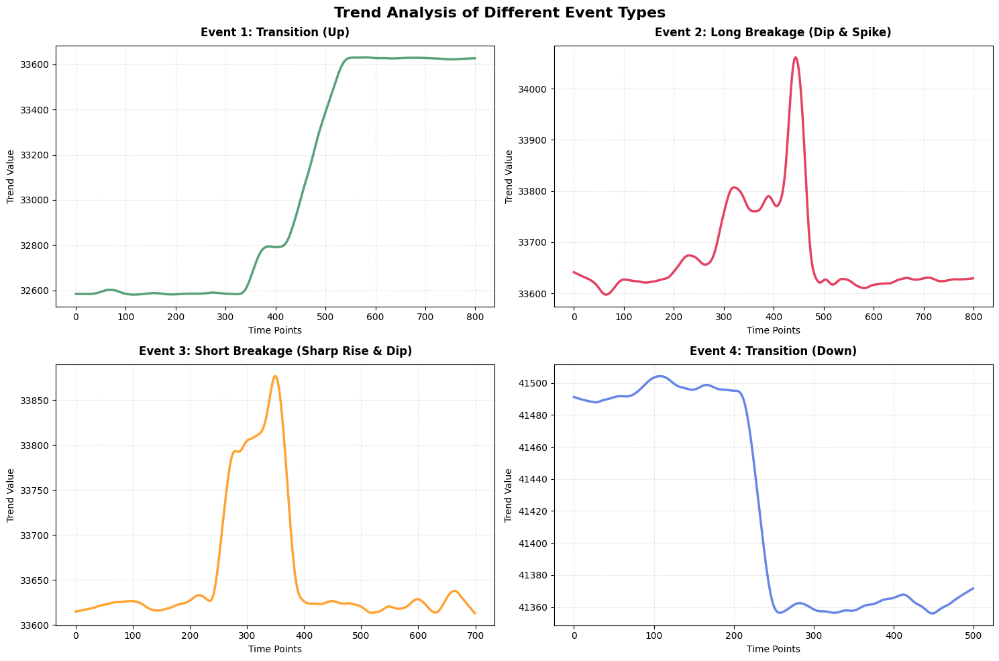

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_event_trends(result1, result2, result3, result4):
    """
    Plot the trend components of 4 different event types in subplots

    Parameters:
    result1, result2, result3, result4: STL decomposition results with .trend attribute
    """

    # Define event names and descriptions
    event_names = [
        "Transition (Up)",
        "Long Breakage (Dip & Spike)",
        "Short Breakage (Sharp Rise & Dip)",
        "Transition (Down)"
    ]

    event_descriptions = [
        "Gradual upward transition",
        "Extended dip followed by spike",
        "Sharp rise followed by sharp dip",
        "Gradual downward transition"
    ]

    # Store the results for easy iteration
    results = [result1, result2, result3, result4]

    # Create color palette for different event types
    colors = ['#2E8B57', '#DC143C', '#FF8C00', '#4169E1']  # Sea Green, Crimson, Dark Orange, Royal Blue

    # Create subplots - 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle('Trend Analysis of Different Event Types', fontsize=16, fontweight='bold')

    # Flatten axes for easy iteration
    axes_flat = axes.flatten()

    for i, (result, name, desc, color, ax) in enumerate(zip(results, event_names, event_descriptions, colors, axes_flat)):
        # Extract trend data
        trend_data = result.trend

        # Plot the trend
        ax.plot(trend_data, color=color, linewidth=2.5, alpha=0.8)

        # Customize each subplot
        ax.set_title(f'Event {i+1}: {name}', fontsize=12, fontweight='bold', pad=10)
        ax.set_xlabel('Time Points', fontsize=10)
        ax.set_ylabel('Trend Value', fontsize=10)
        ax.grid(True, alpha=0.3, linestyle='--')


    plt.tight_layout()
    plt.show()

# Plot individual trends in subplots
plot_event_trends(result1, result2, result3, result4)

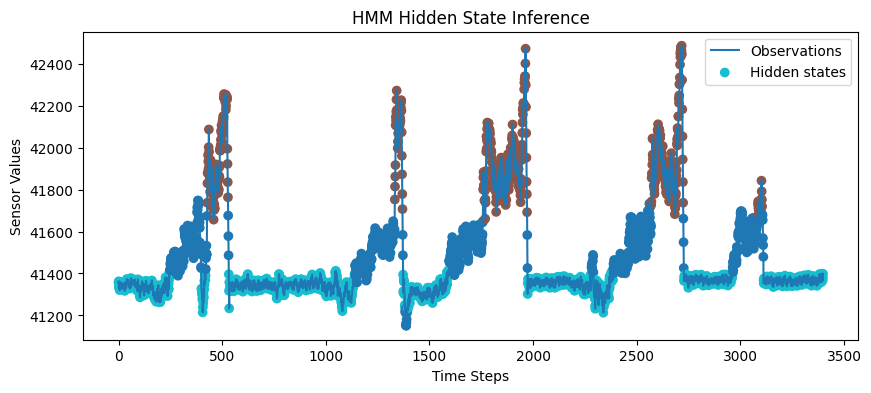

In [ ]:
obs = event5

from hmmlearn.hmm import GaussianHMM

model = GaussianHMM(n_components=3, n_iter=200)
model.fit(obs.reshape(-1, 1))
hs = model.predict(obs.reshape(-1, 1))
plt.figure(figsize=(10, 4))
plt.plot(obs, label="Observations")
plt.scatter(np.arange(len(obs)), obs, c=hs, cmap="tab10", label="Hidden states")
plt.title(f"HMM Hidden State Inference")
plt.legend()
plt.xlabel("Time Steps")
plt.ylabel("Sensor Values")
plt.show()